# Installs

In [ ]:
!pip install gymnasium

In [ ]:
!pip install gymnasium[mujoco]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 25.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.4/243.4 kB 10.4 MB/s eta 0:00:00


In [ ]:
!pip install swig
!pip install "gymnasium[box2d]"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 69.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 kB 21.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for box2d-py: filename=box2d_py-2.3.5-cp311-cp311-linux_x86_64.whl size=2379449 sha256=5186501bbacf68162436e0b29d75d00e637ecb1643d4c8ea5a2ebeb235b12f77
  Stored in directory: /root/.cache/pip/wheels/ab/f1/0c/d56f4a2bdd12bae0a0693ec33f2f0daadb5eb9753c78fa5308
Successfully built box2d-py


In [ ]:
# Install dependencies with additional checks
!apt-get update -q
!apt-get install -y xvfb ffmpeg x11-utils  # x11-utils for additional X11 support
!pip install pyvirtualdisplay gymnasium[mujoco]  # pyopengl is included via mujoco

# Verify Xvfb installation
import subprocess
try:
    result = subprocess.run(['which', 'Xvfb'], check=True, capture_output=True, text=True)
    print("Xvfb found at:", result.stdout.strip())
except subprocess.CalledProcessError:
    print("WARNING: Xvfb not found. Attempting EGL backend if GPU available.")

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:3 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:6 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:7 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:8 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:9 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:11 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,237 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,535 kB]
Get:13 http://security.ubuntu.com/ubuntu jammy-security/main a

# Imports

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.functional import mse_loss
import torch.optim as optim
from torch.distributions import Categorical, Normal
import numpy as np
import pandas as pd
import gymnasium as gym
from gymnasium.wrappers import RecordVideo
from gymnasium.wrappers import RecordEpisodeStatistics
from gymnasium.vector import SyncVectorEnv, AsyncVectorEnv
from collections import deque
import matplotlib.pyplot as plt
from IPython.display import HTML, display
from pyvirtualdisplay import Display
import pyvirtualdisplay
import matplotlib
import IPython
import base64
import io
import imageio
import subprocess
import tempfile
import json
import time
import multiprocessing as mp
from multiprocessing import Process, Manager
from collections import namedtuple
from itertools import cycle, count
from dataclasses import dataclass
import copy
from typing import Callable, Tuple, List, Dict, Optional

# Set up plotting
plt.style.use('fivethirtyeight')
plt.rcParams.update({
    'figure.figsize': (15, 8),
    'font.size': 24,
    'legend.fontsize': 20,
    'axes.titlesize': 28,
    'axes.labelsize': 24,
    'xtick.labelsize': 20,
    'ytick.labelsize': 20
})



In [ ]:
with open('requirements.txt', 'w') as f:
    f.write('''torch>=2.6.0+cu124
              numpy>=2.0.2
              pandas>=2.2.2
              gymnasium>=1.1.1
              matplotlib>=3.10.0
              ipython>=7.34.0
              pyvirtualdisplay>=3.0
              imageio>=2.37.0''')

# REINFORCE

Episode 0: Reward = 40.00
Episode 50: Reward = 13.00
Reached target reward 500 in episode 76.
Model saved to reinforce_final.pt
Final evaluation reward: 320.4


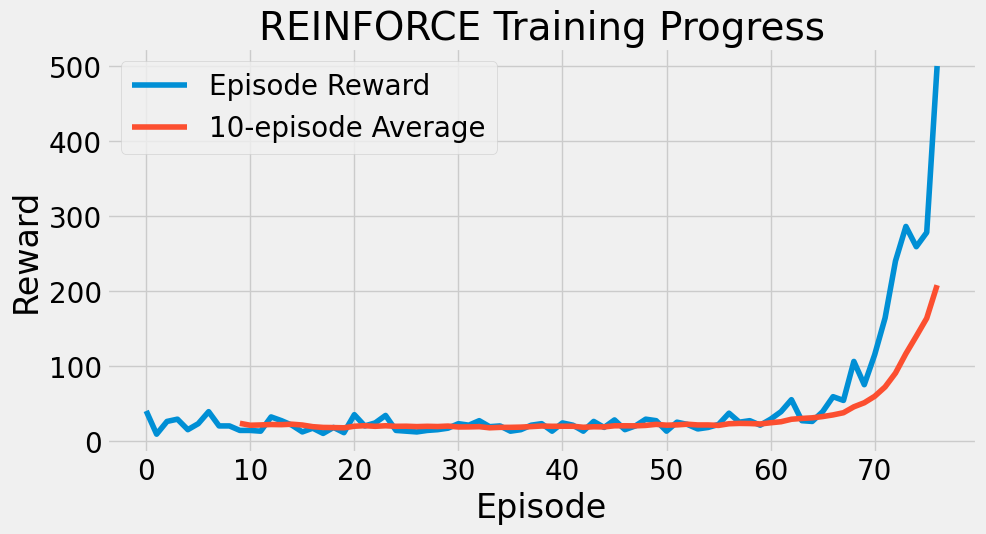


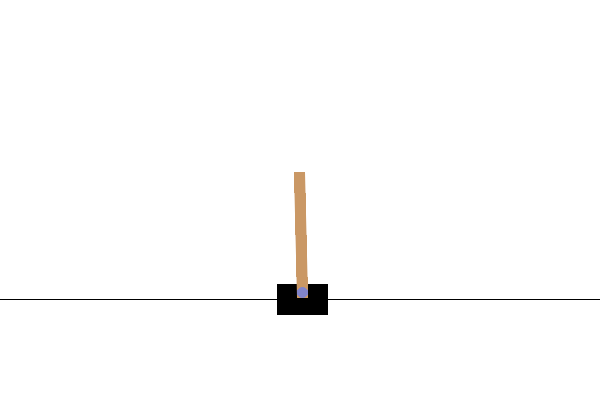

In [ ]:
@dataclass
class REINFORCEConfig:
    gamma: float = 0.99           # Discount factor
    lr: float = 0.005              # Learning rate
    max_grad_norm: float = 1.0    # Gradient clipping norm
    hidden_dims: tuple = (128,64)      # Hidden layer sizes
    print_every: int = 100         # Print rewards every print_every episodes, 0 to disable
    save_every: int = 100          # Save checkpoint every save_every episodes, 0 to disable
    target_reward: int = 500        # Break if we reach our target reward
    episode_reward_window: int = 10 # Window for rolling average evaluation of episode rewards

class FCDAP(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dims=(128, 64), activation_fc=nn.ReLU):
        super().__init__()
        layers = [nn.Linear(input_dim, hidden_dims[0]), activation_fc()]
        for i in range(len(hidden_dims) - 1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i + 1]), activation_fc()])
        layers.append(nn.Linear(hidden_dims[-1], output_dim))
        self.model = nn.Sequential(*layers)

    def forward(self, state):
        if isinstance(state, tuple):
            state = state[0]
        if isinstance(state, np.ndarray):
            state = torch.FloatTensor(state)
        return self.model(state)

    def get_action_and_log_prob(self, state):
        logits = self.forward(state)
        dist = Categorical(logits=logits)
        action = dist.sample()
        log_prob = dist.log_prob(action).unsqueeze(-1)
        return action, log_prob

class REINFORCE:
    def __init__(self, env_name, config=REINFORCEConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.config = config
        self.device = torch.device(device)
        self.env_name = env_name
        self.env = gym.make(env_name)

        self.state_dim = self.env.observation_space.shape[0]
        self.action_dim = self.env.action_space.n

        self.model = FCDAP(self.state_dim, self.action_dim, config.hidden_dims).to(self.device)
        self.optimizer = optim.Adam(self.model.parameters(), lr=config.lr)
        self.episode_rewards = []

    def get_action(self, state):
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        action, log_prob = self.model.get_action_and_log_prob(state)
        return action.item(), log_prob

    def select_action(self, state):
        """Sample action for evaluation/demo without log probability."""
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            logits = self.model(state)
            action = torch.argmax(logits, dim=1)
        return action.item()

    def train(self, max_episodes=1000):
        """Train the agent by collecting full episodes."""
        self.model.train()
        self.loss_trace = []
        self.grad_trace = []
        for episode in range(max_episodes):
            state, _ = self.env.reset()
            log_probs = []
            rewards = []
            episode_reward = 0
            done = False

            # Collect a full episode
            while not done:
                action, log_prob = self.get_action(state)
                next_state, reward, terminated, truncated, _ = self.env.step(action)
                log_probs.append(log_prob)
                rewards.append(reward)
                done = terminated or truncated
                state = next_state

            # Compute discounted returns
            returns = []
            G = 0
            for r in reversed(rewards):
                G = r + self.config.gamma * G
                returns.insert(0, G)

            # Normalize rewards
            returns = torch.tensor(returns)
            returns = (returns - returns.mean()) / (returns.std() + 1e-8)

            # Compute policy loss
            policy_loss = [-log_probs[i] * returns[i] for i in range(len(log_probs))]
            loss = torch.stack(policy_loss).sum()
            self.loss_trace.append(loss)

            self.optimizer.zero_grad()
            loss.backward()

            # Compute overall gradient norm for diagnostic purposes
            total_grad_norm = 0.0
            for name, param in self.model.named_parameters():
                if param.grad is not None:
                    param_norm = param.grad.data.norm(2)
                    total_grad_norm += param_norm.item() ** 2
            total_grad_norm = total_grad_norm ** 0.5
            self.grad_trace.append(total_grad_norm)

            nn.utils.clip_grad_norm_(self.model.parameters(), self.config.max_grad_norm)
            self.optimizer.step()

            # Record episode reward
            episode_reward = sum(rewards)
            self.episode_rewards.append(episode_reward)

            # Logging and checkpoints
            if self.config.print_every > 0 and episode % self.config.print_every == 0:
                print(f"Episode {episode}: Reward = {episode_reward:.2f}")

            if self.config.save_every > 0 and episode % self.config.save_every == 0 and episode > 0:
                self.save_model(f'checkpoint_episode_{episode}.pt')

            if episode_reward >= self.config.target_reward:
                print(f"Reached target reward {self.config.target_reward} in episode {episode}.")
                break

        self.env.close()
        self.save_model('reinforce_final.pt')

    def evaluate(self, n_episodes=5):
        """Evaluate the agent on a single environment."""
        env = gym.make(self.env_name)
        rewards = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            total_reward = 0
            while not done:
                action = self.select_action(state)
                state, reward, terminated, truncated, _ = env.step(action)
                total_reward += reward
                done = terminated or truncated
            rewards.append(total_reward)
        env.close()
        return np.mean(rewards)

    def plot_rewards(self):
        """Plot episode rewards and their moving average."""
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        plt.plot(pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean(), label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('REINFORCE Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=3, max_frames=500, save_path=None):
        """Generate a demonstration of the agent's performance."""
        env = gym.make(self.env_name, render_mode='rgb_array')
        frames = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            step = 0
            while not done and step < max_frames:
                frame = env.render()
                frames.append(frame)
                action = self.select_action(state)
                state, _, terminated, truncated, _ = env.step(action)
                done = terminated or truncated
                step += 1
        env.close()

        if save_path:
            imageio.mimsave(save_path, frames, format='GIF', duration=0.04)
            print(f"Demo saved to {save_path}")
        else:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))

    def save_model(self, path):
        """Save the model and optimizer state."""
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load the model and optimizer state."""
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        print(f"Model loaded from {path}")

if __name__ == "__main__":
    config = REINFORCEConfig(print_every=50, save_every=500)
    reinforce = REINFORCE(env_name="CartPole-v1", config=config)
    reinforce.train(max_episodes=500)
    print("Final evaluation reward:", reinforce.evaluate())
    reinforce.plot_rewards()
    reinforce.demo()

# Vanilla Policy Gradient (i.e. REINFORCE with Baseline)

<ipython-input-5-83ddc63ac930>:70: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  states = torch.FloatTensor(states).to(self.device)
<ipython-input-5-83ddc63ac930>:72: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  returns = torch.tensor(returns, dtype=torch.float32).to(self.device)


Episode 0: Reward = 12.00
Episode 50: Reward = 35.00
Reached target reward 500 in episode 77.
Model saved to vpg_final.pt
Final evaluation reward: 145.2


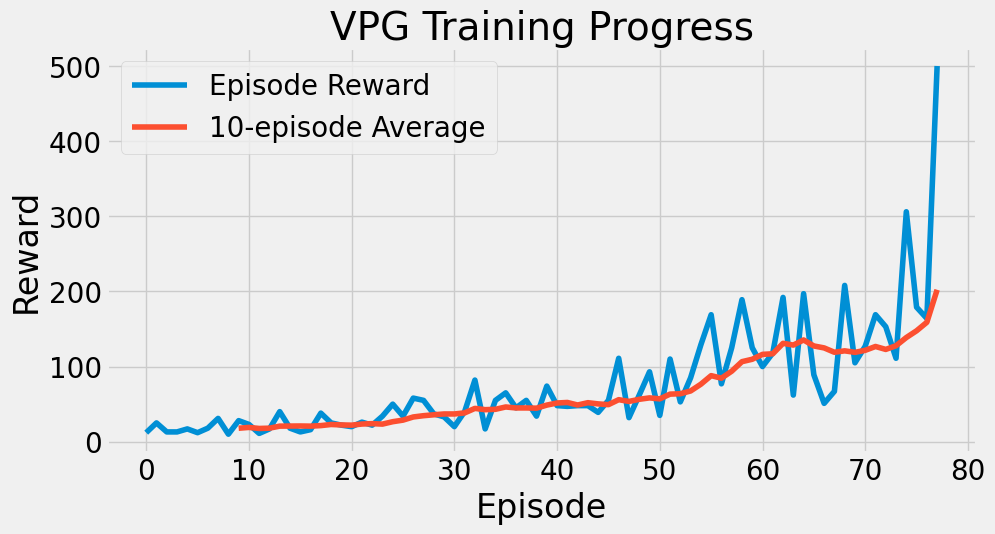


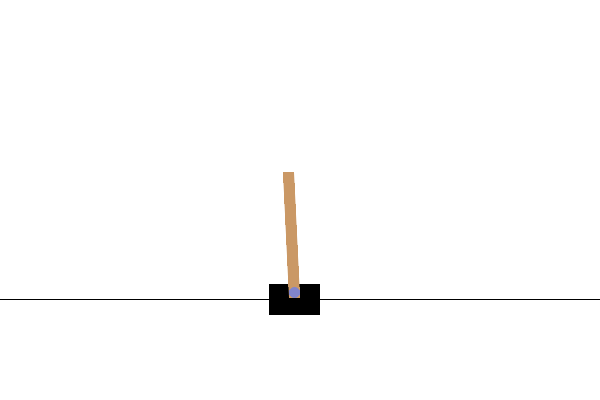

In [ ]:
@dataclass
class VPGConfig:
    gamma: float = 0.99           # Discount factor
    lr: float = 0.005             # Learning rate
    max_grad_norm: float = 1.0    # Gradient clipping norm
    hidden_dims: tuple = (128, 64) # Hidden layer sizes
    print_every: int = 100        # Print rewards every print_every episodes, 0 to disable
    save_every: int = 100         # Save checkpoint every save_every episodes, 0 to disable
    target_reward: int = 500      # Break if we reach target reward
    episode_reward_window: int = 10 # Window for rolling average evaluation of episode rewards
    entropy_coef: float = 0.001   # Entropy loss coefficient (VPG-specific)
    value_loss_coef: float = 0.5  # Value loss coefficient (VPG-specific)

# Actor-Critic model for VPG
class ActorCritic(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dims=(128, 64), activation_fc=nn.ReLU):
        super().__init__()
        layers = [nn.Linear(input_dim, hidden_dims[0]), activation_fc()]
        for i in range(len(hidden_dims) - 1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i + 1]), activation_fc()])
        self.shared = nn.Sequential(*layers)
        self.actor = nn.Linear(hidden_dims[-1], output_dim)  # Outputs logits
        self.critic = nn.Linear(hidden_dims[-1], 1)          # Outputs value

    def forward(self, state):
        if isinstance(state, tuple):
            state = state[0]
        if isinstance(state, np.ndarray):
            state = torch.FloatTensor(state).to(self.device)
        x = self.shared(state)
        logits = self.actor(x)
        value = self.critic(x)
        return logits, value

# VPG class with all REINFORCE functionality and optimizations
class VPG:
    def __init__(self, env_name, config=VPGConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.config = config
        self.device = torch.device(device)
        self.env_name = env_name
        self.env = gym.make(env_name)
        self.state_dim = self.env.observation_space.shape[0]
        self.action_dim = self.env.action_space.n
        self.model = ActorCritic(self.state_dim, self.action_dim, config.hidden_dims).to(self.device)
        self.model.device = self.device  # Add device attribute to model for forward method
        self.optimizer = optim.Adam(self.model.parameters(), lr=config.lr)
        self.episode_rewards = []
        self.loss_trace = []  # Track loss for diagnostics
        self.grad_trace = []  # Track gradient norms for diagnostics

    def get_action(self, state):
        """Sample action during training rollout (simplified for efficiency)."""
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            logits, _ = self.model(state)
            dist = Categorical(logits=logits)
            action = dist.sample()
        return action.item()

    def select_action(self, state):
        """Select action deterministically for evaluation/demo."""
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            logits, _ = self.model(state)
            action = torch.argmax(logits, dim=1)
        return action.item()

    def update(self, states, actions, returns):
        """Update the model with collected episode data."""
        states = torch.FloatTensor(states).to(self.device)
        actions = torch.LongTensor(actions).to(self.device)
        returns = torch.tensor(returns, dtype=torch.float32).to(self.device)

        # Compute current logits and values
        logits, current_values = self.model(states)
        dist = Categorical(logits=logits)
        log_probs = dist.log_prob(actions)
        advantages = returns - current_values.squeeze().detach()  # Use current values for advantage

        # Compute losses
        policy_loss = -(log_probs * advantages).sum()
        value_loss = F.mse_loss(current_values.squeeze(), returns)
        entropy = dist.entropy().mean()
        loss = (policy_loss +
                self.config.value_loss_coef * value_loss -
                self.config.entropy_coef * entropy)

        # Optimize
        self.optimizer.zero_grad()
        loss.backward()
        total_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.model.parameters() if p.grad is not None) ** 0.5
        nn.utils.clip_grad_norm_(self.model.parameters(), self.config.max_grad_norm)
        self.optimizer.step()

        return loss.item(), total_grad_norm

    def train(self, max_episodes=1000):
        """Train the agent by collecting full episodes."""
        self.model.train()
        for episode in range(max_episodes):
            state, _ = self.env.reset()
            states = []
            actions = []
            rewards = []
            done = False

            # Collect a full episode (simplified data collection)
            while not done:
                action = self.get_action(state)
                next_state, reward, terminated, truncated, _ = self.env.step(action)
                states.append(state)
                actions.append(action)
                rewards.append(reward)
                done = terminated or truncated
                state = next_state

            # Compute discounted returns
            returns = []
            G = 0
            for r in reversed(rewards):
                G = r + self.config.gamma * G
                returns.insert(0, G)
            returns = torch.tensor(returns, dtype=torch.float32)

            # Normalize returns
            returns = (returns - returns.mean()) / (returns.std() + 1e-8)

            # Update model
            loss, grad_norm = self.update(states, actions, returns)
            self.loss_trace.append(loss)
            self.grad_trace.append(grad_norm)

            # Record episode reward
            episode_reward = sum(rewards)
            self.episode_rewards.append(episode_reward)

            # Logging and checkpoints
            if self.config.print_every > 0 and episode % self.config.print_every == 0:
                print(f"Episode {episode}: Reward = {episode_reward:.2f}")

            if self.config.save_every > 0 and episode % self.config.save_every == 0 and episode > 0:
                self.save_model(f'checkpoint_episode_{episode}.pt')

            if episode_reward >= self.config.target_reward:
                print(f"Reached target reward {self.config.target_reward} in episode {episode}.")
                break

        self.env.close()
        self.save_model('vpg_final.pt')

    def evaluate(self, n_episodes=5):
        """Evaluate the agent."""
        env = gym.make(self.env_name)
        rewards = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            total_reward = 0
            while not done:
                action = self.select_action(state)
                state, reward, terminated, truncated, _ = env.step(action)
                total_reward += reward
                done = terminated or truncated
            rewards.append(total_reward)
        env.close()
        return np.mean(rewards)

    def plot_rewards(self):
        """Plot episode rewards and moving average."""
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        plt.plot(pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean(),
                 label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('VPG Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=3, max_frames=500, save_path=None):
        """Generate a demonstration of the agent's performance."""
        env = gym.make(self.env_name, render_mode='rgb_array')
        frames = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            step = 0
            while not done and step < max_frames:
                frame = env.render()
                frames.append(frame)
                action = self.select_action(state)
                state, _, terminated, truncated, _ = env.step(action)
                done = terminated or truncated
                step += 1
        env.close()

        if save_path:
            imageio.mimsave(save_path, frames, format='GIF', duration=0.04)
            print(f"Demo saved to {save_path}")
        else:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))

    def save_model(self, path):
        """Save model and optimizer state."""
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load model and optimizer state."""
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        print(f"Model loaded from {path}")

# Main block
if __name__ == "__main__":
    config = VPGConfig(print_every=50, save_every=500)
    vpg = VPG(env_name="CartPole-v1", config=config)
    vpg.train(max_episodes=500)
    print("Final evaluation reward:", vpg.evaluate())
    vpg.plot_rewards()
    vpg.demo()

# A3C (Asynchronous Advantage Actor Critic)

- n-step turns with bootstrapping to learn policy and value functions
- concurrent actors to generate samples in parallel

Step 10000: Average reward of last 10 episodes = 37.70
Step 20000: Average reward of last 10 episodes = 55.50
Step 30000: Average reward of last 10 episodes = 52.20
Step 40000: Average reward of last 10 episodes = 55.00
Step 50000: Average reward of last 10 episodes = 52.80
Step 60000: Average reward of last 10 episodes = 64.50
Step 70000: Average reward of last 10 episodes = 92.20
Step 80000: Average reward of last 10 episodes = 59.70
Step 90000: Average reward of last 10 episodes = 100.20
Step 100000: Average reward of last 10 episodes = 112.30
Model saved to checkpoint_step_100000.pt
Step 110000: Average reward of last 10 episodes = 87.60
Step 120000: Average reward of last 10 episodes = 147.70
Step 130000: Average reward of last 10 episodes = 241.90
Step 140000: Average reward of last 10 episodes = 256.30
Step 150000: Average reward of last 10 episodes = 247.80
Step 160000: Average reward of last 10 episodes = 397.30
Reached target reward 500.0 at step 164720
Model saved to a3c_fin

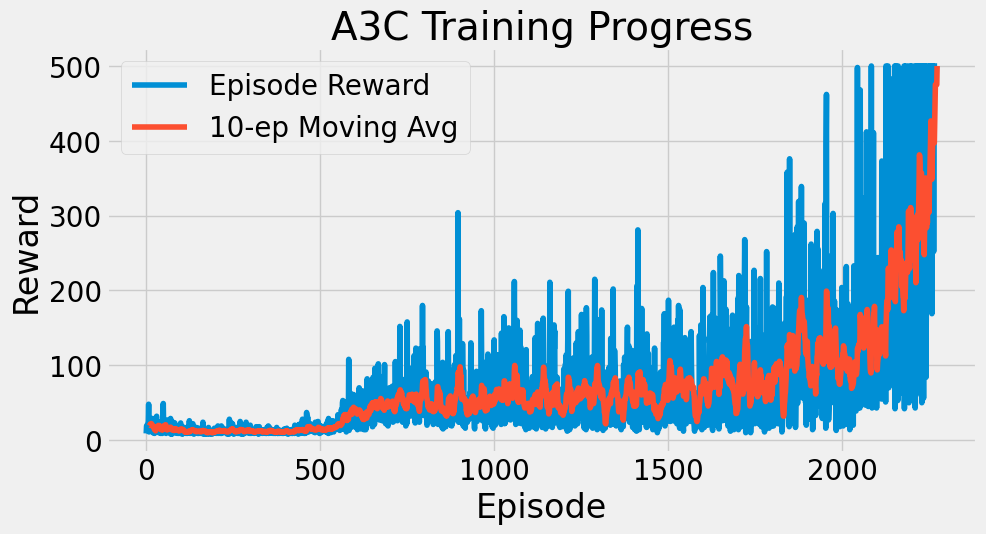


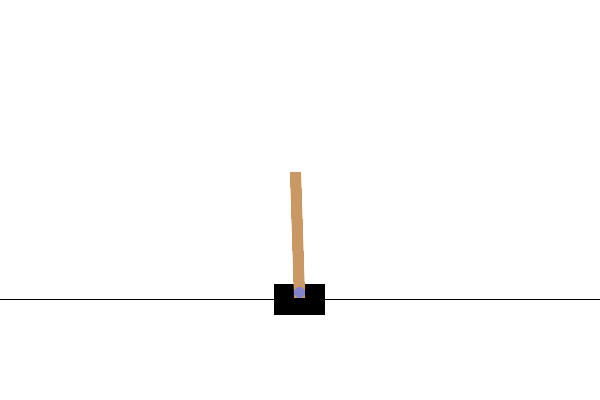

In [ ]:
@dataclass
class A3CConfig:
    """Configuration for A3C agent"""
    gamma: float = 0.99          # Discount factor
    n_envs: int = 4             # Number of parallel environments
    lr: float = 0.001          # Learning rate
    entropy_coef: float = 0.01  # Entropy coefficient
    value_loss_coef: float = 0.5 # Value loss coefficient
    max_grad_norm: float = 0.5  # Max gradient norm
    n_steps: int = 5            # Steps per update
    hidden_dim: int = 64        # Hidden layer size
    print_every: int = 10000    # Print every print_every steps
    save_every: int = 100000    # Save every save_every steps
    target_reward: float = 500.0 # Target average reward
    episode_reward_window: int = 10 # Window for moving average

class ActorCritic(nn.Module):
    """Actor-Critic network with shared layers"""
    def __init__(self, state_dim, action_dim, hidden_dim=64):
        super().__init__()
        self.shared = nn.Sequential(
            nn.Linear(state_dim, hidden_dim),
            nn.Tanh()
        )
        self.actor = nn.Sequential(
            nn.Linear(hidden_dim, action_dim),
            nn.Softmax(dim=-1)
        )
        self.critic = nn.Linear(hidden_dim, 1)

    def forward(self, state):
        """Forward pass for policy and value"""
        features = self.shared(state)
        policy = self.actor(features)
        value = self.critic(features).squeeze(-1)
        return policy, value

class A3C:
    """Synchronous A3C implementation"""
    def __init__(self, env_name, config=A3CConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.config = config
        self.device = torch.device(device)
        self.env_name = env_name

        # Initialize vectorized environments
        self.envs = AsyncVectorEnv([lambda: gym.make(env_name) for _ in range(config.n_envs)])
        self.state_dim = self.envs.single_observation_space.shape[0]
        self.action_dim = self.envs.single_action_space.n

        # Setup model and optimizer
        self.model = ActorCritic(self.state_dim, self.action_dim, config.hidden_dim).to(self.device)
        self.optimizer = optim.Adam(self.model.parameters(), lr=config.lr)

        # Tracking
        self.episode_rewards = []
        self.loss_trace = []
        self.grad_trace = []
        self.total_steps = 0

    def get_action(self, states):
        """Sample actions and get log probs and values"""
        states = torch.FloatTensor(states).to(self.device)
        with torch.no_grad():
            probs, values = self.model(states)
            dist = Categorical(probs)
            actions = dist.sample()
            log_probs = dist.log_prob(actions)
        return actions.cpu().numpy(), log_probs, values

    def compute_returns(self, rewards, next_value, dones):
        """Compute n-step returns"""
        returns = torch.zeros_like(rewards).to(self.device)
        R = next_value
        for t in reversed(range(len(rewards))):
            R = rewards[t] + self.config.gamma * R * (1 - dones[t])
            returns[t] = R
        return returns

    def update(self, states, actions, log_probs, rewards, values, next_value, dones):
        """Update the model"""
        states = torch.FloatTensor(states).to(self.device)
        actions = torch.LongTensor(actions).to(self.device)
        rewards = torch.FloatTensor(rewards).to(self.device)
        dones = torch.FloatTensor(dones).to(self.device)

        # Compute returns
        returns = self.compute_returns(rewards, next_value, dones)

        # Current policy and value
        probs, values = self.model(states)
        dist = Categorical(probs)
        new_log_probs = dist.log_prob(actions)
        entropy = dist.entropy().mean()

        # Losses
        advantages = returns - values.detach()
        policy_loss = -(new_log_probs * advantages.detach()).mean()
        value_loss = F.mse_loss(values, returns)
        loss = (policy_loss +
                self.config.value_loss_coef * value_loss -
                self.config.entropy_coef * entropy)

        # Optimize
        self.optimizer.zero_grad()
        loss.backward()
        total_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.model.parameters() if p.grad is not None) ** 0.5
        nn.utils.clip_grad_norm_(self.model.parameters(), self.config.max_grad_norm)
        self.optimizer.step()

        # Track loss and grad norm
        self.loss_trace.append(loss.item())
        self.grad_trace.append(total_grad_norm)

        return loss.item()

    def train(self, max_steps=500000):
        """Training loop"""
        states, _ = self.envs.reset()
        episode_rewards = np.zeros(self.config.n_envs)

        while self.total_steps < max_steps:
            rollout = {
                'states': [],
                'actions': [],
                'log_probs': [],
                'rewards': [],
                'values': [],
                'dones': []
            }

            # Collect experience
            for _ in range(self.config.n_steps):
                actions, log_probs, values = self.get_action(states)
                next_states, rewards, terminated, truncated, _ = self.envs.step(actions)
                dones = terminated | truncated

                rollout['states'].append(states)
                rollout['actions'].append(actions)
                rollout['log_probs'].append(log_probs)
                rollout['rewards'].append(rewards)
                rollout['values'].append(values)
                rollout['dones'].append(dones)

                states = next_states
                episode_rewards += rewards
                self.total_steps += self.config.n_envs

                # Track completed episodes
                if dones.any():
                    self.episode_rewards.extend(episode_rewards[dones])
                    episode_rewards[dones] = 0

            # Update model
            with torch.no_grad():
                _, next_value = self.model(torch.FloatTensor(states).to(self.device))
            loss = self.update(**rollout, next_value=next_value)

            # Print progress
            if self.total_steps % self.config.print_every == 0 and len(self.episode_rewards) >= self.config.episode_reward_window:
                avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                print(f"Step {self.total_steps}: Average reward of last {self.config.episode_reward_window} episodes = {avg_reward:.2f}")

            # Save checkpoint
            if self.config.save_every > 0 and self.total_steps % self.config.save_every == 0:
                self.save_model(f'checkpoint_step_{self.total_steps}.pt')

            # Check target reward
            if len(self.episode_rewards) >= self.config.episode_reward_window and np.mean(self.episode_rewards[-self.config.episode_reward_window:]) >= self.config.target_reward:
                print(f"Reached target reward {self.config.target_reward} at step {self.total_steps}")
                break

        self.save_model('a3c_final.pt')
        self.envs.close()

    def evaluate(self, n_episodes=5):
        """Evaluate the agent"""
        env = gym.make(self.env_name)
        rewards = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            total_reward = 0
            while not done:
                action, _, _ = self.get_action(np.expand_dims(state, 0))
                state, reward, terminated, truncated, _ = env.step(action[0])
                total_reward += reward
                done = terminated or truncated
            rewards.append(total_reward)
        env.close()
        return np.mean(rewards)

    def plot_rewards(self):
        """Plot training progress"""
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        plt.plot(pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean(),
                 label=f'{self.config.episode_reward_window}-ep Moving Avg')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('A3C Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=2, max_frames=200, save_path=None):
        """Generate a demo video"""
        env = gym.make(self.env_name, render_mode='rgb_array')
        frames = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            step = 0
            while not done and step < max_frames:
                frame = env.render()
                frames.append(frame)
                action, _, _ = self.get_action(np.expand_dims(state, 0))
                state, _, terminated, truncated, _ = env.step(action[0])
                done = terminated or truncated
                step += 1
        env.close()

        if save_path:
            imageio.mimsave(save_path, frames, format='GIF', duration=0.04)
            print(f"Demo saved to {save_path}")
        else:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))

    def save_model(self, path):
        """Save model and optimizer state"""
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load model and optimizer state"""
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        print(f"Model loaded from {path}")

if __name__ == "__main__":
    config = A3CConfig(print_every=10000, save_every=100000, target_reward=500.0, episode_reward_window=10)
    a3c = A3C(env_name='CartPole-v1', config=config)
    a3c.train(max_steps=500000)
    print("Final evaluation reward:", a3c.evaluate())
    a3c.plot_rewards()
    a3c.demo()

# GAE (Generalized Advantage Estimate)

Step 10000: Average reward of last 10 episodes = 30.10
Step 20000: Average reward of last 10 episodes = 32.80
Step 30000: Average reward of last 10 episodes = 48.90
Step 40000: Average reward of last 10 episodes = 38.90
Step 50000: Average reward of last 10 episodes = 48.50
Step 60000: Average reward of last 10 episodes = 41.60
Step 70000: Average reward of last 10 episodes = 91.50
Step 80000: Average reward of last 10 episodes = 46.50
Step 90000: Average reward of last 10 episodes = 91.80
Step 100000: Average reward of last 10 episodes = 107.20
Model saved to checkpoint_step_100000.pt
Step 110000: Average reward of last 10 episodes = 165.30
Step 120000: Average reward of last 10 episodes = 278.50
Step 130000: Average reward of last 10 episodes = 95.70
Step 140000: Average reward of last 10 episodes = 185.00
Step 150000: Average reward of last 10 episodes = 228.80
Step 160000: Average reward of last 10 episodes = 230.70
Step 170000: Average reward of last 10 episodes = 302.80
Step 1800

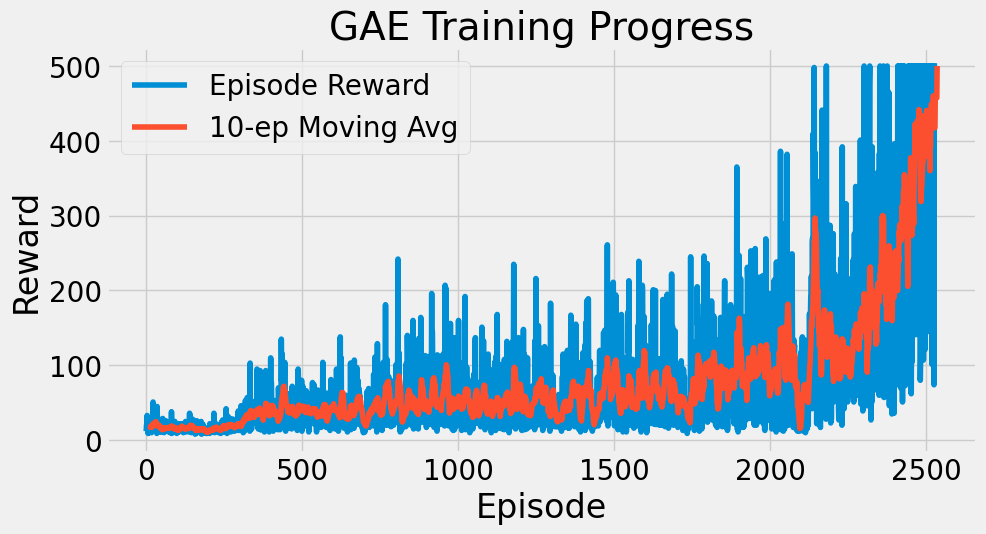


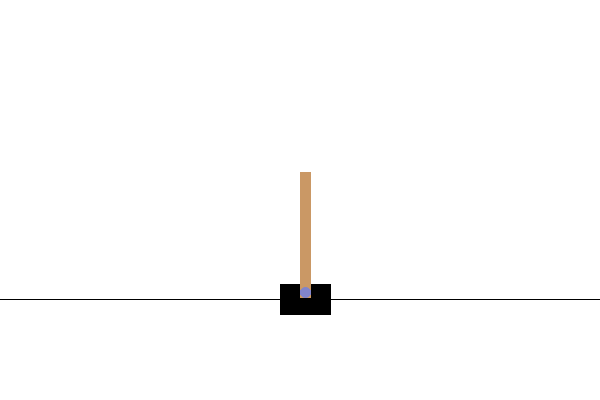

In [ ]:
@dataclass
class GAEConfig:
    """Configuration for GAE agent"""
    gamma: float = 0.99          # Discount factor
    tau: float = 0.95            # GAE lambda parameter
    n_envs: int = 4             # Number of parallel environments
    lr: float = 0.001          # Learning rate
    entropy_coef: float = 0.01  # Entropy coefficient
    value_loss_coef: float = 0.5 # Value loss coefficient
    max_grad_norm: float = 0.5  # Max gradient norm
    n_steps: int = 5            # Steps per update
    hidden_dim: int = 64        # Hidden layer size
    print_every: int = 10000    # Print every print_every steps
    save_every: int = 100000    # Save every save_every steps
    target_reward: float = 500.0 # Target average reward
    episode_reward_window: int = 10 # Window for moving average

class ActorCritic(nn.Module):
    """Actor-Critic network with shared layers"""
    def __init__(self, state_dim, action_dim, hidden_dim=64):
        super().__init__()
        self.shared = nn.Sequential(
            nn.Linear(state_dim, hidden_dim),
            nn.Tanh()
        )
        self.actor = nn.Sequential(
            nn.Linear(hidden_dim, action_dim),
            nn.Softmax(dim=-1)
        )
        self.critic = nn.Linear(hidden_dim, 1)

    def forward(self, state):
        """Forward pass for policy and value"""
        features = self.shared(state)
        policy = self.actor(features)
        value = self.critic(features).squeeze(-1)
        return policy, value

class GAE:
    """Synchronous GAE implementation"""
    def __init__(self, env_name, config=GAEConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.config = config
        self.device = torch.device(device)
        self.env_name = env_name

        # Initialize vectorized environments
        self.envs = AsyncVectorEnv([lambda: gym.make(env_name) for _ in range(config.n_envs)])
        self.state_dim = self.envs.single_observation_space.shape[0]
        self.action_dim = self.envs.single_action_space.n

        # Setup model and optimizer
        self.model = ActorCritic(self.state_dim, self.action_dim, config.hidden_dim).to(self.device)
        self.optimizer = optim.Adam(self.model.parameters(), lr=config.lr)

        # Tracking
        self.episode_rewards = []
        self.loss_trace = []
        self.grad_trace = []
        self.total_steps = 0

    def get_action(self, states):
        """Sample actions and get log probs and values"""
        states = torch.FloatTensor(states).to(self.device)
        with torch.no_grad():
            probs, values = self.model(states)
            dist = Categorical(probs)
            actions = dist.sample()
            log_probs = dist.log_prob(actions)
        return actions.cpu().numpy(), log_probs, values

    def compute_returns(self, rewards, next_value, dones):
        """Compute n-step returns"""
        returns = torch.zeros_like(rewards).to(self.device)
        R = next_value
        for t in reversed(range(len(rewards))):
            R = rewards[t] + self.config.gamma * R * (1 - dones[t])
            returns[t] = R
        return returns

    def update(self, states, actions, log_probs, rewards, values, next_value, dones):
        """Update the model using GAE"""
        states = torch.FloatTensor(states).to(self.device)
        actions = torch.LongTensor(actions).to(self.device)
        rewards = torch.FloatTensor(rewards).to(self.device)
        dones = torch.FloatTensor(dones).to(self.device)
        values = torch.stack(values).to(self.device)  # Old values from rollout: (n_steps, n_envs)

        # Compute returns for value loss
        returns = self.compute_returns(rewards, next_value, dones)

        # Compute GAE advantages
        advantages = torch.zeros((self.config.n_steps, self.config.n_envs), device=self.device)
        gae = torch.zeros(self.config.n_envs, device=self.device)
        for t in reversed(range(self.config.n_steps)):
            if t == self.config.n_steps - 1:
                V_next = next_value * (1 - dones[t])
            else:
                V_next = values[t + 1] * (1 - dones[t])
            delta = rewards[t] + self.config.gamma * V_next - values[t]
            gae = delta + self.config.gamma * self.config.tau * (1 - dones[t]) * gae
            advantages[t] = gae

        # Current policy and value
        probs, current_values = self.model(states)
        dist = Categorical(probs)
        new_log_probs = dist.log_prob(actions)
        entropy = dist.entropy().mean()

        # Losses
        policy_loss = -(new_log_probs * advantages.detach()).mean()
        value_loss = F.mse_loss(current_values, returns)
        loss = (policy_loss +
                self.config.value_loss_coef * value_loss -
                self.config.entropy_coef * entropy)

        # Optimize
        self.optimizer.zero_grad()
        loss.backward()
        total_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.model.parameters() if p.grad is not None) ** 0.5
        nn.utils.clip_grad_norm_(self.model.parameters(), self.config.max_grad_norm)
        self.optimizer.step()

        # Track loss and grad norm
        self.loss_trace.append(loss.item())
        self.grad_trace.append(total_grad_norm)

        return loss.item()

    def train(self, max_steps=500000):
        """Training loop"""
        states, _ = self.envs.reset()
        episode_rewards = np.zeros(self.config.n_envs)

        while self.total_steps < max_steps:
            rollout = {
                'states': [],
                'actions': [],
                'log_probs': [],
                'rewards': [],
                'values': [],
                'dones': []
            }

            # Collect experience
            for _ in range(self.config.n_steps):
                actions, log_probs, values = self.get_action(states)
                next_states, rewards, terminated, truncated, _ = self.envs.step(actions)
                dones = terminated | truncated

                rollout['states'].append(states)
                rollout['actions'].append(actions)
                rollout['log_probs'].append(log_probs)
                rollout['rewards'].append(rewards)
                rollout['values'].append(values)
                rollout['dones'].append(dones)

                states = next_states
                episode_rewards += rewards
                self.total_steps += self.config.n_envs

                # Track completed episodes
                if dones.any():
                    self.episode_rewards.extend(episode_rewards[dones])
                    episode_rewards[dones] = 0

            # Update model
            with torch.no_grad():
                _, next_value = self.model(torch.FloatTensor(states).to(self.device))
            loss = self.update(**rollout, next_value=next_value)

            # Print progress
            if self.total_steps % self.config.print_every == 0 and len(self.episode_rewards) >= self.config.episode_reward_window:
                avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                print(f"Step {self.total_steps}: Average reward of last {self.config.episode_reward_window} episodes = {avg_reward:.2f}")

            # Save checkpoint
            if self.config.save_every > 0 and self.total_steps % self.config.save_every == 0:
                self.save_model(f'checkpoint_step_{self.total_steps}.pt')

            # Check target reward
            if len(self.episode_rewards) >= self.config.episode_reward_window and np.mean(self.episode_rewards[-self.config.episode_reward_window:]) >= self.config.target_reward:
                print(f"Reached target reward {self.config.target_reward} at step {self.total_steps}")
                break

        self.save_model('gae_final.pt')
        self.envs.close()

    def evaluate(self, n_episodes=5):
        """Evaluate the agent"""
        env = gym.make(self.env_name)
        rewards = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            total_reward = 0
            while not done:
                action, _, _ = self.get_action(np.expand_dims(state, 0))
                state, reward, terminated, truncated, _ = env.step(action[0])
                total_reward += reward
                done = terminated or truncated
            rewards.append(total_reward)
        env.close()
        return np.mean(rewards)

    def plot_rewards(self):
        """Plot training progress"""
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        plt.plot(pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean(),
                 label=f'{self.config.episode_reward_window}-ep Moving Avg')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('GAE Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=2, max_frames=200, save_path=None):
        """Generate a demo video"""
        env = gym.make(self.env_name, render_mode='rgb_array')
        frames = []
        for _ in range(n_episodes):
            state, _ = env.reset()
            done = False
            step = 0
            while not done and step < max_frames:
                frame = env.render()
                frames.append(frame)
                action, _, _ = self.get_action(np.expand_dims(state, 0))
                state, _, terminated, truncated, _ = env.step(action[0])
                done = terminated or truncated
                step += 1
        env.close()

        if save_path:
            imageio.mimsave(save_path, frames, format='GIF', duration=0.04)
            print(f"Demo saved to {save_path}")
        else:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))

    def save_model(self, path):
        """Save model and optimizer state"""
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load model and optimizer state"""
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        print(f"Model loaded from {path}")

if __name__ == "__main__":
    config = GAEConfig(print_every=10000, save_every=1000000, target_reward=500.0, episode_reward_window=10)
    gae = GAE(env_name='CartPole-v1', config=config)
    gae.train(max_steps=500000)
    print("Final evaluation reward:", gae.evaluate())
    gae.plot_rewards()
    gae.demo()

# A2C (Advantage Actor Critic)

Step 10000: Average reward of last 100 episodes = 20.15
Step 20000: Average reward of last 100 episodes = 21.09
Step 30000: Average reward of last 100 episodes = 26.47
Step 40000: Average reward of last 100 episodes = 30.83
Step 50000: Average reward of last 100 episodes = 36.88
Step 60000: Average reward of last 100 episodes = 44.43
Step 70000: Average reward of last 100 episodes = 48.91
Step 80000: Average reward of last 100 episodes = 66.32
Step 90000: Average reward of last 100 episodes = 58.84
Step 100000: Average reward of last 100 episodes = 65.87
Step 110000: Average reward of last 100 episodes = 72.31
Step 120000: Average reward of last 100 episodes = 65.60
Step 130000: Average reward of last 100 episodes = 87.27
Step 140000: Average reward of last 100 episodes = 82.37
Step 150000: Average reward of last 100 episodes = 76.71
Step 160000: Average reward of last 100 episodes = 100.50
Step 170000: Average reward of last 100 episodes = 107.52
Step 180000: Average reward of last 10

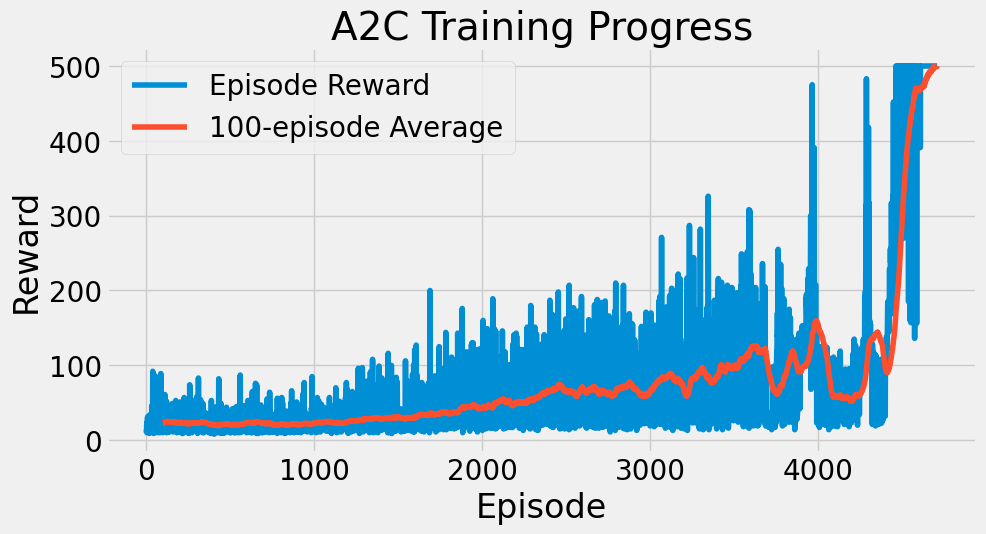

Demonstrating trained agent:



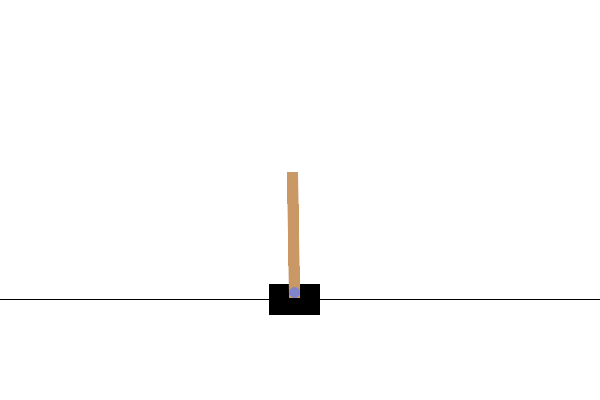

In [ ]:
@dataclass
class A2CConfig:
    """Configuration for A2C agent"""
    gamma: float = 0.99          # Discount factor for future rewards
    n_envs: int = 4             # Number of parallel environments
    lr: float = 0.0003         # Learning rate for optimizer
    entropy_coef: float = 0.05  # Entropy bonus coefficient
    value_loss_coef: float = 0.5 # Value loss coefficient
    max_grad_norm: float = 0.5  # Maximum gradient norm for clipping
    n_steps: int = 10            # Steps per update
    hidden_dims: tuple = (64, 64) # Hidden layer sizes
    print_every: int = 10000    # Print every print_every steps
    save_every: int = 1000000    # Save every save_every steps
    target_reward: float = 500.0 # Target average reward for early stopping
    episode_reward_window: int = 100 # Window for moving average of rewards

class ActorCritic(nn.Module):
    """Combined Actor-Critic network"""
    def __init__(self, state_dim, action_dim, hidden_dims=(64, 64)):
        super().__init__()
        # Shared layers for feature extraction
        layers = [nn.Linear(state_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        self.shared = nn.Sequential(*layers)

        # Actor head for policy
        self.actor = nn.Sequential(
            nn.Linear(hidden_dims[-1], action_dim),
            nn.Softmax(dim=-1)
        )

        # Critic head for value estimation
        self.critic = nn.Linear(hidden_dims[-1], 1)

    def forward(self, state):
        """Forward pass returns policy probabilities and value estimate"""
        features = self.shared(state)
        policy = self.actor(features)
        value = self.critic(features).squeeze(-1)
        return policy, value

class A2C:
    """Advantage Actor-Critic (A2C) implementation"""
    def __init__(self, env_name, config=A2CConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.config = config
        self.device = torch.device(device)

        # Create parallel environments
        self.envs = AsyncVectorEnv([lambda: gym.make(env_name) for _ in range(config.n_envs)])
        self.state_dim = self.envs.single_observation_space.shape[0]
        self.action_dim = self.envs.single_action_space.n

        # Initialize network and optimizer
        self.model = ActorCritic(self.state_dim, self.action_dim, config.hidden_dims).to(device)
        self.optimizer = optim.Adam(self.model.parameters(), lr=config.lr)

        # Tracking for visualization and monitoring
        self.episode_rewards = []
        self.total_steps = 0
        self.loss_trace = []
        self.grad_trace = []

    def get_action(self, states):
        """Sample actions from the policy and get log probabilities and values"""
        states = torch.FloatTensor(states).to(self.device)
        with torch.no_grad():
            probs, values = self.model(states)
            dist = Categorical(probs)
            actions = dist.sample()
            log_probs = dist.log_prob(actions)
        return actions.cpu().numpy(), log_probs, values

    def compute_advantages(self, rewards, values, next_value, dones):
        """Compute GAE (Generalized Advantage Estimation) and returns"""
        advantages = torch.zeros_like(rewards).to(self.device)
        returns = torch.zeros_like(rewards).to(self.device)
        gae = 0

        # Work backwards to compute advantages
        for t in reversed(range(len(rewards))):
            mask = 1.0 - dones[t]
            delta = rewards[t] + self.config.gamma * next_value * mask - values[t]
            gae = delta + self.config.gamma * 0.95 * gae * mask
            advantages[t] = gae
            returns[t] = gae + values[t]
            next_value = values[t]

        # Normalize advantages for stability
        advantages = (advantages - advantages.mean()) / (advantages.std() + 1e-8)
        return advantages, returns

    def update(self, states, actions, log_probs, rewards, values, next_value, dones):
        """Perform one training update"""
        # Convert collected data to tensors
        states = torch.FloatTensor(states).to(self.device)
        actions = torch.LongTensor(actions).to(self.device)
        old_log_probs = torch.stack(log_probs).to(self.device)
        rewards = torch.FloatTensor(rewards).to(self.device)
        values = torch.stack(values).to(self.device)
        dones = torch.FloatTensor(dones).to(self.device)

        # Compute advantages and returns
        advantages, returns = self.compute_advantages(rewards, values, next_value, dones)

        # Forward pass with current model
        probs, values = self.model(states)
        dist = Categorical(probs)
        new_log_probs = dist.log_prob(actions)
        entropy = dist.entropy().mean()

        # Compute losses
        policy_loss = -(new_log_probs * advantages.detach()).mean()
        value_loss = nn.functional.mse_loss(values, returns.detach())
        loss = (policy_loss +
                self.config.value_loss_coef * value_loss -
                self.config.entropy_coef * entropy)

        # Optimize and track gradient norm
        self.optimizer.zero_grad()
        loss.backward()
        total_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.model.parameters() if p.grad is not None) ** 0.5
        nn.utils.clip_grad_norm_(self.model.parameters(), self.config.max_grad_norm)
        self.optimizer.step()

        # Store metrics
        self.loss_trace.append(loss.item())
        self.grad_trace.append(total_grad_norm)

        return loss.item()

    def train(self, max_steps=1000000, evaluate_every=50000):
        """Main training loop"""
        states, _ = self.envs.reset()
        current_episode_rewards = np.zeros(self.config.n_envs)  # Track rewards per environment

        rollout = {
            'states': [],
            'actions': [],
            'log_probs': [],
            'rewards': [],
            'values': [],
            'dones': []
        }

        while self.total_steps < max_steps:
            # Collect n_steps of experience
            for _ in range(self.config.n_steps):
                actions, log_probs, values = self.get_action(states)
                next_states, rewards, terminated, truncated, _ = self.envs.step(actions)
                dones = terminated | truncated

                # Store experience
                rollout['states'].append(states)
                rollout['actions'].append(actions)
                rollout['log_probs'].append(log_probs)
                rollout['rewards'].append(rewards)
                rollout['values'].append(values)
                rollout['dones'].append(dones)

                states = next_states
                current_episode_rewards += rewards
                self.total_steps += self.config.n_envs

                # Handle episode ends
                if dones.any():
                    finished_rewards = current_episode_rewards[dones]
                    self.episode_rewards.extend(finished_rewards.tolist())
                    current_episode_rewards[dones] = 0

            # Compute next value and update
            with torch.no_grad():
                _, next_value = self.model(torch.FloatTensor(states).to(self.device))
            loss = self.update(**rollout, next_value=next_value)

            # Clear rollout
            for k in rollout:
                rollout[k].clear()

            # Print progress
            if self.total_steps % self.config.print_every == 0 and len(self.episode_rewards) >= self.config.episode_reward_window:
                avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                print(f"Step {self.total_steps}: Average reward of last {self.config.episode_reward_window} episodes = {avg_reward:.2f}")

            # Save model
            if self.config.save_every > 0 and self.total_steps % self.config.save_every == 0:
                self.save_model(f'checkpoint_step_{self.total_steps}.pt')

            # Early stopping
            if (len(self.episode_rewards) >= self.config.episode_reward_window and
                np.mean(self.episode_rewards[-self.config.episode_reward_window:]) >= self.config.target_reward):
                print(f"Reached target reward {self.config.target_reward} at step {self.total_steps}")
                self.save_model('a2c_final.pt')
                break

        # Finalize training
        self.save_model('a2c_final.pt')
        self.envs.close()

    def evaluate(self, n_episodes=5):
        """Evaluate the agent's performance"""
        eval_env = gym.make(self.envs.env_fns[0]().spec.id)
        rewards = []

        for _ in range(n_episodes):
            state, _ = eval_env.reset()
            episode_reward = 0
            done = False
            while not done:
                action, _, _ = self.get_action(np.expand_dims(state, 0))
                state, reward, terminated, truncated, _ = eval_env.step(action[0])
                episode_reward += reward
                done = terminated or truncated
            rewards.append(episode_reward)

        eval_env.close()
        return np.mean(rewards)

    def plot_rewards(self):
        """Visualize training progress"""
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        plt.plot(pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean(),
                 label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('A2C Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=3, max_frames=500):
        """Generate a demonstration video of the trained agent"""
        env = gym.make(self.envs.env_fns[0]().spec.id, render_mode='rgb_array')
        frames = []

        for _ in range(n_episodes):
            state, _ = env.reset()
            episode_frames = []
            done = False
            step = 0

            while not done and step < max_frames:
                frame = env.render()
                episode_frames.append(frame)
                action, _, _ = self.get_action(np.expand_dims(state, 0))
                state, _, terminated, truncated, _ = env.step(action[0])
                done = terminated or truncated
                step += 1

            frames.extend(episode_frames)

        # Save and display GIF
        output = io.BytesIO()
        imageio.mimsave(output, frames, format='GIF', duration=0.04)
        gif_bytes = output.getvalue()
        b64 = base64.b64encode(gif_bytes).decode('ascii')
        html = f'<img src="data:image/gif;base64,{b64}" />'
        display(HTML(html))

        env.close()
        return frames

    def save_model(self, path):
        """Save the model and optimizer state"""
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load the model and optimizer state"""
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        print(f"Model loaded from {path}")

if __name__ == "__main__":
    a2c = A2C(env_name='CartPole-v1', config=A2CConfig())
    a2c.train(max_steps=1000000)

    # Show results
    print("Final evaluation reward:", a2c.evaluate())
    a2c.plot_rewards()
    print("Demonstrating trained agent:")
    a2c.demo(n_episodes=2)

# DDPG (Deep Deterministic Policy Gradient)

Episode 0: Reward = -1213.63, Steps = 200, Total Steps = 200, Avg Reward (100) = -1213.63
Step 10000: Average reward of last 50 episodes = -755.05
Step 11000: Average reward of last 50 episodes = -657.16
Step 12000: Average reward of last 50 episodes = -537.09
Step 13000: Average reward of last 50 episodes = -450.20
Step 14000: Average reward of last 50 episodes = -367.36
Step 15000: Average reward of last 50 episodes = -319.98
Step 16000: Average reward of last 50 episodes = -265.34
Step 17000: Average reward of last 50 episodes = -312.06
Step 18000: Average reward of last 50 episodes = -301.65
Step 19000: Average reward of last 50 episodes = -290.07
Step 20000: Average reward of last 50 episodes = -259.28
Step 21000: Average reward of last 50 episodes = -248.68
Step 22000: Average reward of last 50 episodes = -245.05
Step 23000: Average reward of last 50 episodes = -225.44
Step 24000: Average reward of last 50 episodes = -215.53
Step 25000: Average reward of last 50 episodes = -224.9


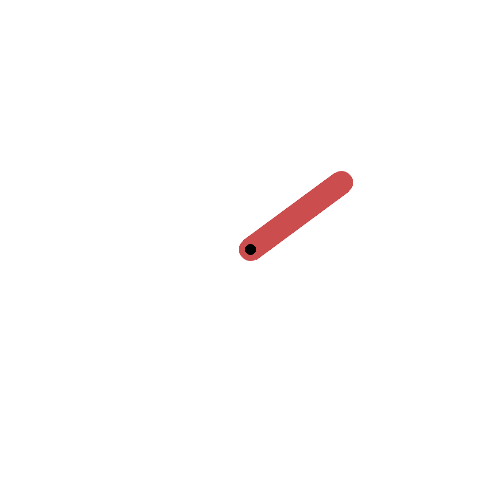

In [ ]:
@dataclass
class DDPGConfig:
    gamma: float = 0.99          # Discount factor for future rewards
    tau: float = 0.005          # Soft update parameter for target networks
    buffer_size: int = 100000   # Maximum size of replay buffer
    batch_size: int = 256       # Number of samples per training batch
    actor_lr: float = 0.0001    # Learning rate for actor network
    critic_lr: float = 0.001    # Learning rate for critic network
    hidden_dims: tuple = (256, 256)  # Sizes of hidden layers
    noise_scale: float = 0.1    # Scale of exploration noise
    warmup_steps: int = 1000    # Steps before training begins
    print_every: int = 1000      # Print every print_every episodes, 0 to disable
    save_every: int = 10000       # Save every save_every episodes, 0 to disable
    target_reward: float = -150.0 # Target average reward for early stopping
    episode_reward_window: int = 10 # Window for moving average of rewards

class ReplayBuffer:
    """Stores and samples experiences for training"""
    def __init__(self, max_size, state_dim, action_dim):
        self.max_size = max_size
        self.ptr = 0
        self.size = 0
        self.state = np.zeros((max_size, state_dim))
        self.action = np.zeros((max_size, action_dim))
        self.next_state = np.zeros((max_size, state_dim))
        self.reward = np.zeros((max_size, 1))
        self.done = np.zeros((max_size, 1))

    def add(self, state, action, reward, next_state, done):
        self.state[self.ptr] = state
        self.action[self.ptr] = action
        self.reward[self.ptr] = reward
        self.next_state[self.ptr] = next_state
        self.done[self.ptr] = done
        self.ptr = (self.ptr + 1) % self.max_size
        self.size = min(self.size + 1, self.max_size)

    def sample(self, batch_size):
        idx = np.random.randint(0, self.size, size=batch_size)
        return (
            torch.FloatTensor(self.state[idx]),
            torch.FloatTensor(self.action[idx]),
            torch.FloatTensor(self.reward[idx]),
            torch.FloatTensor(self.next_state[idx]),
            torch.FloatTensor(self.done[idx])
        )

class Actor(nn.Module):
    """Policy network that maps states to actions"""
    def __init__(self, state_dim, action_dim, max_action, hidden_dims=(256, 256)):
        super().__init__()
        layers = [nn.Linear(state_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        layers.append(nn.Linear(hidden_dims[-1], action_dim))
        layers.append(nn.Tanh())
        self.net = nn.Sequential(*layers)
        self.max_action = max_action

    def forward(self, state):
        return self.max_action * self.net(state)

class Critic(nn.Module):
    """Q-value network that estimates state-action values"""
    def __init__(self, state_dim, action_dim, hidden_dims=(256, 256)):
        super().__init__()
        layers = [nn.Linear(state_dim + action_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        layers.append(nn.Linear(hidden_dims[-1], 1))
        self.net = nn.Sequential(*layers)

    def forward(self, state, action):
        sa = torch.cat([state, action], dim=-1)
        return self.net(sa)

class DDPG:
    """Deep Deterministic Policy Gradient implementation"""
    def __init__(self, env, config=DDPGConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.env = env
        self.config = config
        self.device = torch.device(device)
        state_dim = env.observation_space.shape[0]
        action_dim = env.action_space.shape[0]
        self.max_action = float(env.action_space.high[0])
        self.actor = Actor(state_dim, action_dim, self.max_action, config.hidden_dims).to(device)
        self.actor_target = copy.deepcopy(self.actor)
        self.actor_optimizer = optim.Adam(self.actor.parameters(), lr=config.actor_lr)
        self.critic = Critic(state_dim, action_dim, config.hidden_dims).to(device)
        self.critic_target = copy.deepcopy(self.critic)
        self.critic_optimizer = optim.Adam(self.critic.parameters(), lr=config.critic_lr)
        self.buffer = ReplayBuffer(config.buffer_size, state_dim, action_dim)
        self.total_steps = 0
        self.episode_rewards = []  # List to store rewards per episode
        self.loss_trace = []       # List to store (critic_loss, actor_loss) per update
        self.grad_trace = []       # List to store (critic_grad_norm, actor_grad_norm) per update

    def act(self, state, training=True):
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            action = self.actor(state).cpu().numpy()[0]
        if training:
            noise = np.random.normal(0, self.config.noise_scale * self.max_action,
                                    size=self.env.action_space.shape[0])
            action = np.clip(action + noise, self.env.action_space.low, self.env.action_space.high)
        return action

    def update(self):
        if self.buffer.size < self.config.batch_size:
            return
        states, actions, rewards, next_states, dones = [t.to(self.device) for t in self.buffer.sample(self.config.batch_size)]
        with torch.no_grad():
            next_actions = self.actor_target(next_states)
            target_q = rewards + (1 - dones) * self.config.gamma * self.critic_target(next_states, next_actions)
        current_q = self.critic(states, actions)
        critic_loss = nn.functional.mse_loss(current_q, target_q)
        self.critic_optimizer.zero_grad()
        critic_loss.backward()
        critic_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.critic.parameters() if p.grad is not None) ** 0.5
        self.critic_optimizer.step()
        actor_loss = -self.critic(states, self.actor(states)).mean()
        self.actor_optimizer.zero_grad()
        actor_loss.backward()
        actor_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.actor.parameters() if p.grad is not None) ** 0.5
        self.actor_optimizer.step()
        # soft update
        for target_param, param in zip(self.actor_target.parameters(), self.actor.parameters()):
            target_param.data.copy_(self.config.tau * param.data + (1 - self.config.tau) * target_param.data)
        for target_param, param in zip(self.critic_target.parameters(), self.critic.parameters()):
            target_param.data.copy_(self.config.tau * param.data + (1 - self.config.tau) * target_param.data)
        # Track losses and gradient norms
        self.loss_trace.append((critic_loss.item(), actor_loss.item()))
        self.grad_trace.append((critic_grad_norm, actor_grad_norm))

    def train(self, max_steps=100000, evaluate_every=5000, eval_episodes=5):
        """Main training loop"""
        state, _ = self.env.reset()
        episode_reward = 0
        episode_steps = 0
        episode = 0
        rewards = deque(maxlen=100)

        while self.total_steps < max_steps:
            action = self.act(state, training=True)
            next_state, reward, terminated, truncated, _ = self.env.step(action)
            done = terminated or truncated
            self.buffer.add(state, action, reward, next_state, done)
            self.update()
            state = next_state
            episode_reward += reward
            episode_steps += 1
            self.total_steps += 1

            if done:
                self.episode_rewards.append(episode_reward)
                rewards.append(episode_reward)
                if self.config.print_every > 0 and episode % self.config.print_every == 0:
                    print(f"Episode {episode}: Reward = {episode_reward:.2f}, "
                          f"Steps = {episode_steps}, Total Steps = {self.total_steps}, "
                          f"Avg Reward ({self.config.episode_reward_window}) = {np.mean(self.episode_rewards[-self.config.episode_reward_window:]):.2f}")
                if self.config.save_every > 0 and episode % self.config.save_every == 0 and episode > 0:
                    self.save_model(f'checkpoint_episode_{episode}.pt')
                state, _ = self.env.reset()
                episode_reward = 0
                episode_steps = 0
                episode += 1

            # Early stopping based on episode_reward_window
            if len(self.episode_rewards) >= self.config.episode_reward_window:
                avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                if self.total_steps % self.config.print_every == 0:
                    print(f"Step {self.total_steps}: Average reward of last "
                          f"{self.config.episode_reward_window} episodes = {avg_reward:.2f}")
                if avg_reward >= self.config.target_reward:
                    print(f"Reached target reward {self.config.target_reward} at step {self.total_steps}")
                    break

        self.save_model('ddpg_final.pt')

    def evaluate(self, n_episodes=5, render=False):
        rewards = []
        for _ in range(n_episodes):
            state, _ = self.env.reset()
            episode_reward = 0
            done = False
            while not done:
                action = self.act(state, training=False)
                state, reward, terminated, truncated, _ = self.env.step(action)
                episode_reward += reward
                done = terminated or truncated
                if render:
                    self.env.render()
            rewards.append(episode_reward)
        return np.mean(rewards)

    def plot_rewards(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        plt.plot(pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean(), label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_loss(self):
        critic_losses, actor_losses = zip(*self.loss_trace)
        plt.figure(figsize=(10, 5))
        plt.plot(critic_losses, label='Critic Loss')
        plt.plot(actor_losses, label='Actor Loss')
        plt.xlabel('Update Step')
        plt.ylabel('Loss')
        plt.title('Loss Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_grad_norms(self):
        critic_grads, actor_grads = zip(*self.grad_trace)
        plt.figure(figsize=(10, 5))
        plt.plot(critic_grads, label='Critic Gradient Norm')
        plt.plot(actor_grads, label='Actor Gradient Norm')
        plt.xlabel('Update Step')
        plt.ylabel('Gradient Norm')
        plt.title('Gradient Norm Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=3, max_frames=500, save_path=None):
        """Generate a demonstration video of the trained agent"""
        frames = []
        for episode in range(n_episodes):
            state, _ = self.env.reset()
            episode_frames = []
            done = False
            step = 0
            while not done and step < max_frames:
                frame = self.env.render()
                episode_frames.append(frame)
                action = self.act(state, training=False)
                state, reward, terminated, truncated, _ = self.env.step(action)
                done = terminated or truncated
                step += 1
            frames.extend(episode_frames)
        if save_path:
            imageio.mimsave(save_path, frames, format='GIF', duration=0.04)
            print(f"Demo saved to {save_path}")
        else:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))

    def save_model(self, path):
        """Save model and optimizer states"""
        torch.save({
            'actor_state_dict': self.actor.state_dict(),
            'actor_target_state_dict': self.actor_target.state_dict(),
            'critic_state_dict': self.critic.state_dict(),
            'critic_target_state_dict': self.critic_target.state_dict(),
            'actor_optimizer_state_dict': self.actor_optimizer.state_dict(),
            'critic_optimizer_state_dict': self.critic_optimizer.state_dict(),
            'total_steps': self.total_steps
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load model and optimizer states"""
        checkpoint = torch.load(path)
        self.actor.load_state_dict(checkpoint['actor_state_dict'])
        self.actor_target.load_state_dict(checkpoint['actor_target_state_dict'])
        self.critic.load_state_dict(checkpoint['critic_state_dict'])
        self.critic_target.load_state_dict(checkpoint['critic_target_state_dict'])
        self.actor_optimizer.load_state_dict(checkpoint['actor_optimizer_state_dict'])
        self.critic_optimizer.load_state_dict(checkpoint['critic_optimizer_state_dict'])
        self.total_steps = checkpoint['total_steps']
        print(f"Model loaded from {path}")

if __name__ == "__main__":
    env = gym.make("Pendulum-v1", render_mode='rgb_array')
    agent = DDPG(env)
    agent.train(max_steps=100000)
    agent.plot_rewards()
    print("Demonstrating trained agent:")
    agent.demo(n_episodes=2)
    env.close()

# TD3 (Twin Delayed DDPG)

Virtual display started successfully.
Episode 0: Reward = 14.63, Steps = 22, Total Steps = 22, Avg Reward (10) = 14.63
Evaluation at step 20000: Mean reward = 171.65
Evaluation at step 30000: Mean reward = 178.05
Evaluation at step 40000: Mean reward = 209.70
Evaluation at step 50000: Mean reward = 213.26
Episode 1000: Reward = 211.14, Steps = 96, Total Steps = 52588, Avg Reward (10) = 201.30
Evaluation at step 60000: Mean reward = 205.66
Evaluation at step 70000: Mean reward = 296.50
Evaluation at step 80000: Mean reward = 296.71
Evaluation at step 90000: Mean reward = 305.47
Evaluation at step 100000: Mean reward = 317.28
Model saved to td3_final.pt


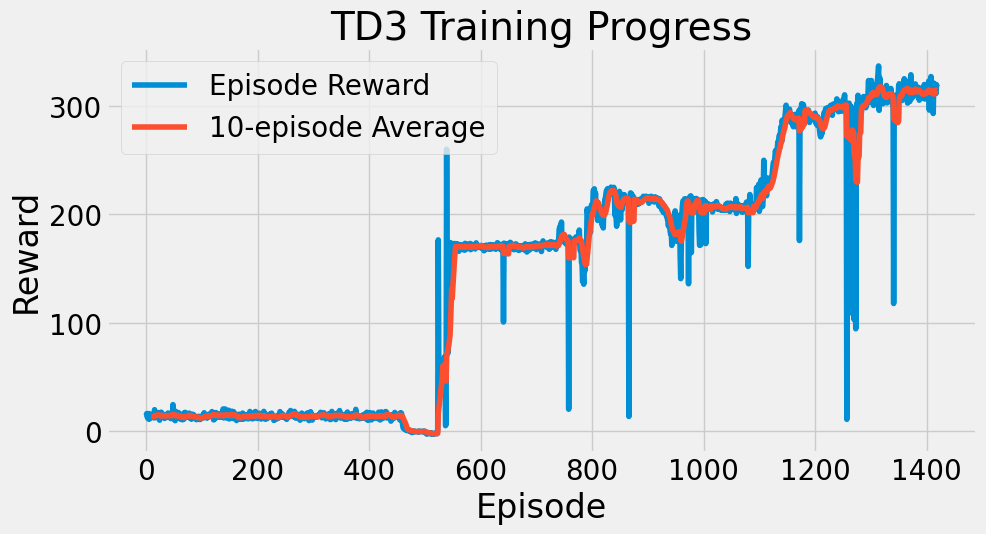

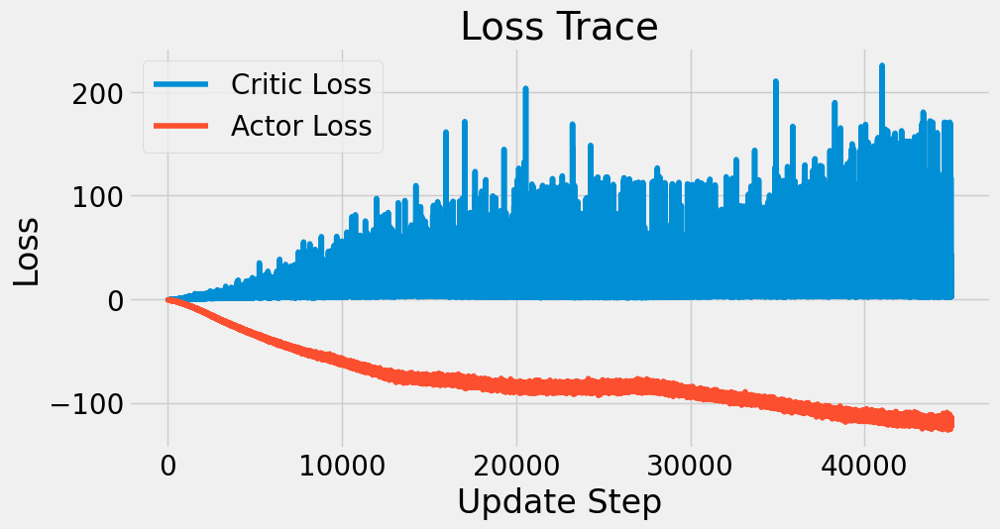

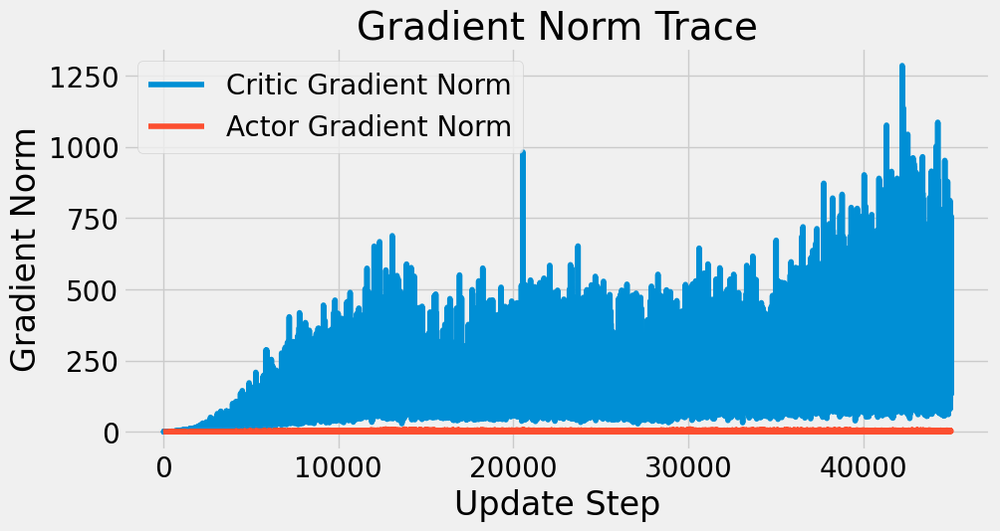

Demonstrating trained agent:



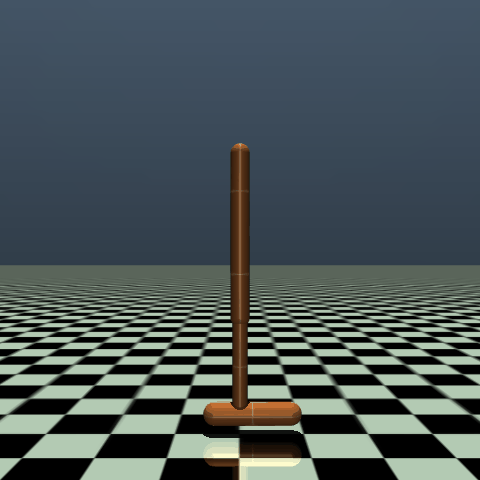

In [ ]:
@dataclass
class TD3Config:
    gamma: float = 0.99          # Discount factor
    tau: float = 0.005          # Soft update parameter
    buffer_size: int = 1000000  # Large buffer for complex environment
    batch_size: int = 256       # Standard batch size
    actor_lr: float = 0.0003    # Actor learning rate
    critic_lr: float = 0.0003   # Critic learning rate
    hidden_dims: tuple = (256, 256)  # Typical network size for PyBullet envs
    noise_scale: float = 0.1    # Exploration noise scale
    policy_noise: float = 0.2   # Target policy smoothing noise
    noise_clip: float = 0.5     # Clipping for policy noise
    warmup_steps: int = 10000   # Warmup steps for sufficient exploration
    policy_freq: int = 2        # Policy update frequency (TD3 standard)
    max_grad_norm: float = 0.5  # Gradient clipping norm
    print_every: int = 1000      # Print every print_every episodes, 0 to disable
    save_every: int = 10000       # Save every save_every episodes, 0 to disable
    target_reward: float = 2500.0 # Target average reward for early stopping
    episode_reward_window: int = 10 # Window for moving average of rewards

class ReplayBuffer:
    def __init__(self, max_size, state_dim, action_dim):
        self.max_size = max_size
        self.ptr = 0
        self.size = 0
        self.state = np.zeros((max_size, state_dim))
        self.action = np.zeros((max_size, action_dim))
        self.next_state = np.zeros((max_size, state_dim))
        self.reward = np.zeros((max_size, 1))
        self.done = np.zeros((max_size, 1))

    def add(self, state, action, reward, next_state, done):
        self.state[self.ptr] = state
        self.action[self.ptr] = action
        self.reward[self.ptr] = reward
        self.next_state[self.ptr] = next_state
        self.done[self.ptr] = done
        self.ptr = (self.ptr + 1) % self.max_size
        self.size = min(self.size + 1, self.max_size)

    def sample(self, batch_size):
        idx = np.random.randint(0, self.size, size=batch_size)
        return (
            torch.FloatTensor(self.state[idx]),
            torch.FloatTensor(self.action[idx]),
            torch.FloatTensor(self.reward[idx]),
            torch.FloatTensor(self.next_state[idx]),
            torch.FloatTensor(self.done[idx])
        )

class Actor(nn.Module):
    def __init__(self, state_dim, action_dim, max_action, hidden_dims=(256, 256)):
        super().__init__()
        layers = [nn.Linear(state_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        layers.append(nn.Linear(hidden_dims[-1], action_dim))
        layers.append(nn.Tanh())
        self.net = nn.Sequential(*layers)
        self.max_action = max_action

    def forward(self, state):
        return self.max_action * self.net(state)

class Critic(nn.Module):
    def __init__(self, state_dim, action_dim, hidden_dims=(256, 256)):
        super().__init__()
        self.q1 = self._build_network(state_dim, action_dim, hidden_dims)
        self.q2 = self._build_network(state_dim, action_dim, hidden_dims)

    def _build_network(self, state_dim, action_dim, hidden_dims):
        layers = [nn.Linear(state_dim + action_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        layers.append(nn.Linear(hidden_dims[-1], 1))
        return nn.Sequential(*layers)

    def forward(self, state, action):
        sa = torch.cat([state, action], dim=-1)
        return self.q1(sa), self.q2(sa)

    def Q1(self, state, action):
        sa = torch.cat([state, action], dim=-1)
        return self.q1(sa)

class TD3:
    def __init__(self, env, config=TD3Config(),
                 device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.env = env
        self.config = config
        self.device = torch.device(device)

        self.state_dim = env.observation_space.shape[0]
        self.action_dim = env.action_space.shape[0]
        self.max_action = float(env.action_space.high[0])
        self.min_action = float(env.action_space.low[0])

        # Initialize networks
        self.actor = Actor(self.state_dim, self.action_dim, self.max_action,
                          config.hidden_dims).to(device)
        self.actor_target = copy.deepcopy(self.actor)
        self.actor_optimizer = optim.Adam(self.actor.parameters(), lr=config.actor_lr)

        self.critic = Critic(self.state_dim, self.action_dim, config.hidden_dims).to(device)
        self.critic_target = copy.deepcopy(self.critic)
        self.critic_optimizer = optim.Adam(self.critic.parameters(), lr=config.critic_lr)

        self.buffer = ReplayBuffer(config.buffer_size, self.state_dim, self.action_dim)
        self.total_steps = 0
        self.episode_rewards = []  # Track rewards per episode
        self.loss_trace = []       # Track (critic_loss, actor_loss) per update
        self.grad_trace = []       # Track (critic_grad_norm, actor_grad_norm) per update

    def act(self, state, training=True):
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            action = self.actor(state).cpu().numpy()[0]
        if training:
            noise = np.random.normal(0, self.config.noise_scale * self.max_action,
                                    size=self.action_dim)
            action = np.clip(action + noise, self.min_action, self.max_action)
        return action

    def update(self):
        if self.buffer.size < self.config.batch_size or self.total_steps < self.config.warmup_steps:
            return

        states, actions, rewards, next_states, dones = [
            t.to(self.device) for t in self.buffer.sample(self.config.batch_size)
        ]

        # Update critic
        with torch.no_grad():
            noise = torch.normal(0, self.config.policy_noise * self.max_action,
                                 size=actions.shape).to(self.device)
            noise = noise.clamp(-self.config.noise_clip * self.max_action,
                                self.config.noise_clip * self.max_action)
            next_actions = self.actor_target(next_states) + noise
            next_actions = next_actions.clamp(self.min_action, self.max_action)
            target_q1, target_q2 = self.critic_target(next_states, next_actions)
            target_q = torch.min(target_q1, target_q2)
            target_q = rewards + (1 - dones) * self.config.gamma * target_q

        current_q1, current_q2 = self.critic(states, actions)
        critic_loss = F.mse_loss(current_q1, target_q) + F.mse_loss(current_q2, target_q)

        self.critic_optimizer.zero_grad()
        critic_loss.backward()
        critic_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.critic.parameters() if p.grad is not None) ** 0.5
        torch.nn.utils.clip_grad_norm_(self.critic.parameters(), self.config.max_grad_norm)
        self.critic_optimizer.step()

        actor_loss = None
        actor_grad_norm = None
        if self.total_steps % self.config.policy_freq == 0:
            actor_loss = -self.critic.Q1(states, self.actor(states)).mean()
            self.actor_optimizer.zero_grad()
            actor_loss.backward()
            actor_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.actor.parameters() if p.grad is not None) ** 0.5
            torch.nn.utils.clip_grad_norm_(self.actor.parameters(), self.config.max_grad_norm)
            self.actor_optimizer.step()
            self._soft_update(self.actor_target, self.actor)
            self._soft_update(self.critic_target, self.critic)

        self.loss_trace.append((critic_loss.item(), actor_loss.item() if actor_loss is not None else None))
        self.grad_trace.append((critic_grad_norm, actor_grad_norm if actor_grad_norm is not None else None))

    def _soft_update(self, target, source):
        for target_param, param in zip(target.parameters(), source.parameters()):
            target_param.data.copy_(
                self.config.tau * param.data + (1 - self.config.tau) * target_param.data)

    def train(self, max_steps=100000, evaluate_every=25000, eval_episodes=5):
        state, _ = self.env.reset()
        episode_reward = 0
        episode_steps = 0
        episode = 0
        rewards = deque(maxlen=100)

        while self.total_steps < max_steps:
            action = self.act(state, training=True)
            next_state, reward, terminated, truncated, _ = self.env.step(action)
            done = terminated or truncated

            self.buffer.add(state, action, reward, next_state, done)
            self.update()

            state = next_state
            episode_reward += reward
            episode_steps += 1
            self.total_steps += 1

            if done:
                self.episode_rewards.append(episode_reward)
                rewards.append(episode_reward)
                if self.config.print_every > 0 and episode % self.config.print_every == 0:
                    avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:]) if len(self.episode_rewards) >= self.config.episode_reward_window else np.mean(self.episode_rewards)
                    print(f"Episode {episode}: Reward = {episode_reward:.2f}, "
                          f"Steps = {episode_steps}, Total Steps = {self.total_steps}, "
                          f"Avg Reward ({self.config.episode_reward_window}) = {avg_reward:.2f}")
                if self.config.save_every > 0 and episode % self.config.save_every == 0 and episode > 0:
                    self.save_model(f'checkpoint_episode_{episode}.pt')
                state, _ = self.env.reset()
                episode_reward = 0
                episode_steps = 0
                episode += 1

                # Early stopping
                if len(self.episode_rewards) >= self.config.episode_reward_window:
                    avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                    if avg_reward >= self.config.target_reward:
                        print(f"Reached target reward {self.config.target_reward} at episode {episode}")
                        self.save_model('td3_final.pt')
                        break

            if self.total_steps % evaluate_every == 0 and self.total_steps > self.config.warmup_steps:
                eval_reward = self.evaluate(n_episodes=eval_episodes)
                print(f"Evaluation at step {self.total_steps}: Mean reward = {eval_reward:.2f}")

        self.save_model('td3_final.pt')
        return np.array(self.episode_rewards)

    def evaluate(self, n_episodes=5, render=False):
        rewards = []
        for _ in range(n_episodes):
            state, _ = self.env.reset()
            episode_reward = 0
            done = False
            while not done:
                action = self.act(state, training=False)
                state, reward, terminated, truncated, _ = self.env.step(action)
                episode_reward += reward
                done = terminated or truncated
                if render:
                    self.env.render()
            rewards.append(episode_reward)
        return np.mean(rewards)

    def save_model(self, path):
        torch.save({
            'actor_state_dict': self.actor.state_dict(),
            'actor_target_state_dict': self.actor_target.state_dict(),
            'critic_state_dict': self.critic.state_dict(),
            'critic_target_state_dict': self.critic_target.state_dict(),
            'actor_optimizer_state_dict': self.actor_optimizer.state_dict(),
            'critic_optimizer_state_dict': self.critic_optimizer.state_dict(),
            'total_steps': self.total_steps
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        checkpoint = torch.load(path)
        self.actor.load_state_dict(checkpoint['actor_state_dict'])
        self.actor_target.load_state_dict(checkpoint['actor_target_state_dict'])
        self.critic.load_state_dict(checkpoint['critic_state_dict'])
        self.critic_target.load_state_dict(checkpoint['critic_target_state_dict'])
        self.actor_optimizer.load_state_dict(checkpoint['actor_optimizer_state_dict'])
        self.critic_optimizer.load_state_dict(checkpoint['critic_optimizer_state_dict'])
        self.total_steps = checkpoint['total_steps']
        print(f"Model loaded from {path}")

    def plot_rewards(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        moving_avg = pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean()
        plt.plot(moving_avg, label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('TD3 Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_loss(self):
        critic_losses, actor_losses = zip(*[(cl, al) for cl, al in self.loss_trace if al is not None])
        plt.figure(figsize=(10, 5))
        plt.plot(critic_losses, label='Critic Loss')
        plt.plot(actor_losses, label='Actor Loss')
        plt.xlabel('Update Step')
        plt.ylabel('Loss')
        plt.title('Loss Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_grad_norms(self):
        critic_grads, actor_grads = zip(*[(cg, ag) for cg, ag in self.grad_trace if ag is not None])
        plt.figure(figsize=(10, 5))
        plt.plot(critic_grads, label='Critic Gradient Norm')
        plt.plot(actor_grads, label='Actor Gradient Norm')
        plt.xlabel('Update Step')
        plt.ylabel('Gradient Norm')
        plt.title('Gradient Norm Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=3, max_frames=500):
        frames = []
        for _ in range(n_episodes):
            state, _ = self.env.reset()
            episode_frames = []
            done = False
            step = 0
            while not done and step < max_frames:
                frame = self.env.render()
                if frame is not None:
                    episode_frames.append(frame)
                action = self.act(state, training=False)
                state, reward, terminated, truncated, _ = self.env.step(action)
                done = terminated or truncated
                step += 1
            frames.extend(episode_frames)
        if frames:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))
        return frames

if __name__ == "__main__":
    try:
        virtual_display = Display(visible=0, size=(1400, 900))
        virtual_display.start()
        print("Virtual display started successfully.")
    except (FileNotFoundError, NameError):
        print("Xvfb not found. Attempting to proceed with EGL if GPU available.")
        if torch.cuda.is_available():
            os.environ['MUJOCO_GL'] = 'egl'
        else:
            print("No GPU available. Rendering will be skipped.")
    env = gym.make("Hopper-v5", render_mode='rgb_array')
    agent = TD3(env)
    results = agent.train(
        max_steps=100e3,
        evaluate_every=10000,
        eval_episodes=5
    )
    agent.plot_rewards()
    print("Demonstrating trained agent:")
    agent.demo(n_episodes=2)
    env.close()
    try:
        virtual_display.stop()
    except NameError:
        pass

# SAC (Soft-Actor Critic)

Virtual display started successfully.
Episode 0: Reward = -237.05, Steps = 1000, Total Steps = 1000, Avg Reward (10) = -237.05
Evaluation at step 5000: Mean reward = -196.89
Evaluation at step 10000: Mean reward = -174.56
Evaluation at step 15000: Mean reward = -257.10
Evaluation at step 20000: Mean reward = -96.83
Evaluation at step 25000: Mean reward = 199.59
Evaluation at step 30000: Mean reward = 576.58
Evaluation at step 35000: Mean reward = 1602.34
Evaluation at step 40000: Mean reward = 1834.83
Evaluation at step 45000: Mean reward = 2431.61
Evaluation at step 50000: Mean reward = 2374.51
Evaluation at step 55000: Mean reward = 2994.46
Evaluation at step 60000: Mean reward = 3215.92
Reached target reward 3000.0 at episode 65
Model saved to sac_final.pt
Model saved to sac_final.pt


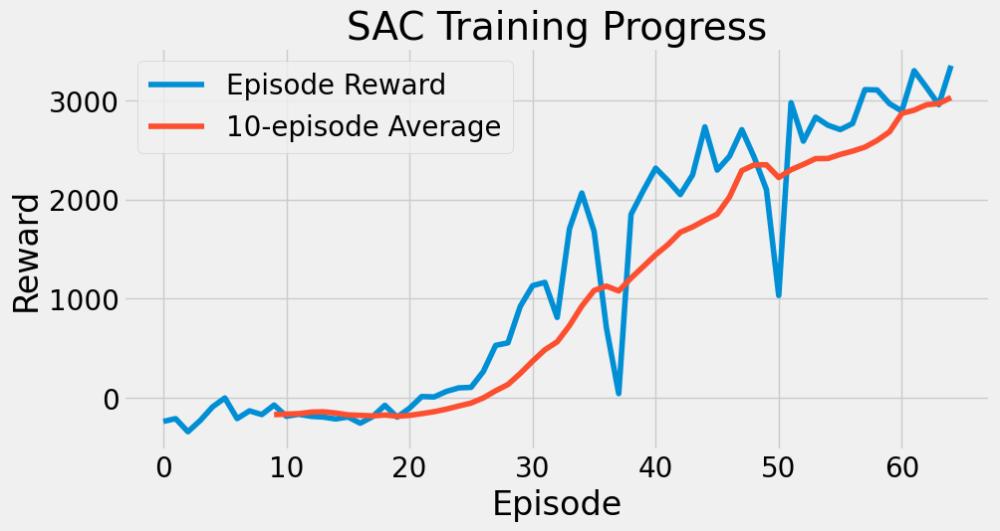

Demonstrating trained agent:



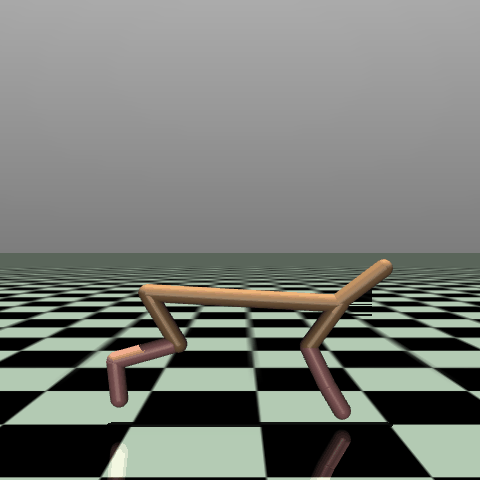

In [ ]:
@dataclass
class SACConfig:
    gamma: float = 0.99          # Discount factor
    tau: float = 0.005          # Soft update parameter
    buffer_size: int = 1000000  # Replay buffer size
    batch_size: int = 256       # Training batch size
    actor_lr: float = 0.0003    # Actor learning rate
    critic_lr: float = 0.0003   # Critic learning rate
    alpha_lr: float = 0.0003    # Temperature learning rate
    hidden_dims: tuple = (256, 256)  # Hidden layer sizes
    warmup_steps: int = 1000    # Steps before training begins
    max_grad_norm: float = 0.5  # Gradient clipping norm
    print_every: int = 1000      # Print every print_every episodes, 0 to disable
    save_every: int = 10000       # Save every save_every episodes, 0 to disable
    target_reward: float = 3000.0 # Target average reward for early stopping
    episode_reward_window: int = 10 # Window for moving average of rewards

class ReplayBuffer:
    def __init__(self, max_size, state_dim, action_dim):
        self.max_size = max_size
        self.ptr = 0
        self.size = 0
        self.state = np.zeros((max_size, state_dim))
        self.action = np.zeros((max_size, action_dim))
        self.next_state = np.zeros((max_size, state_dim))
        self.reward = np.zeros((max_size, 1))
        self.done = np.zeros((max_size, 1))

    def add(self, state, action, reward, next_state, done):
        self.state[self.ptr] = state
        self.action[self.ptr] = action
        self.reward[self.ptr] = reward
        self.next_state[self.ptr] = next_state
        self.done[self.ptr] = done
        self.ptr = (self.ptr + 1) % self.max_size
        self.size = min(self.size + 1, self.max_size)

    def sample(self, batch_size):
        idx = np.random.randint(0, self.size, size=batch_size)
        return (
            torch.FloatTensor(self.state[idx]),
            torch.FloatTensor(self.action[idx]),
            torch.FloatTensor(self.reward[idx]),
            torch.FloatTensor(self.next_state[idx]),
            torch.FloatTensor(self.done[idx])
        )

class Critic(nn.Module):
    """Q-value network for SAC (twin critics)"""
    def __init__(self, state_dim, action_dim, hidden_dims=(256, 256)):
        super().__init__()
        self.q1 = self._build_network(state_dim, action_dim, hidden_dims)
        self.q2 = self._build_network(state_dim, action_dim, hidden_dims)

    def _build_network(self, state_dim, action_dim, hidden_dims):
        layers = [nn.Linear(state_dim + action_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        layers.append(nn.Linear(hidden_dims[-1], 1))
        return nn.Sequential(*layers)

    def forward(self, state, action):
        sa = torch.cat([state, action], dim=-1)
        return self.q1(sa), self.q2(sa)

class Actor(nn.Module):
    """Gaussian policy network for SAC"""
    def __init__(self, state_dim, action_dim, max_action, hidden_dims=(256, 256)):
        super().__init__()
        self.max_action = max_action
        self.log_std_min = -20
        self.log_std_max = 2
        layers = [nn.Linear(state_dim, hidden_dims[0]), nn.ReLU()]
        for i in range(len(hidden_dims)-1):
            layers.extend([nn.Linear(hidden_dims[i], hidden_dims[i+1]), nn.ReLU()])
        self.mean_net = nn.Sequential(*layers, nn.Linear(hidden_dims[-1], action_dim))
        self.log_std_net = nn.Sequential(*layers, nn.Linear(hidden_dims[-1], action_dim))

    def forward(self, state):
        mean = self.mean_net(state)
        log_std = self.log_std_net(state)
        log_std = torch.clamp(log_std, self.log_std_min, self.log_std_max)
        return mean, log_std

    def sample(self, state, epsilon=1e-6):
        mean, log_std = self.forward(state)
        std = log_std.exp()
        normal = Normal(mean, std)
        z = normal.rsample()
        action = torch.tanh(z)
        log_prob = normal.log_prob(z) - torch.log(1 - action.pow(2) + epsilon)
        log_prob = log_prob.sum(dim=-1, keepdim=True)
        return self.max_action * action, log_prob, self.max_action * torch.tanh(mean)

class SAC:
    def __init__(self, env, config=SACConfig(), device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.env = env
        self.config = config
        self.device = torch.device(device)
        self.state_dim = env.observation_space.shape[0]
        self.action_dim = env.action_space.shape[0]
        self.max_action = float(env.action_space.high[0])
        self.min_action = float(env.action_space.low[0])
        self.actor = Actor(self.state_dim, self.action_dim, self.max_action, config.hidden_dims).to(device)
        self.actor_optimizer = optim.Adam(self.actor.parameters(), lr=config.actor_lr)
        self.critic = Critic(self.state_dim, self.action_dim, config.hidden_dims).to(device)
        self.critic_target = copy.deepcopy(self.critic)
        self.critic_optimizer = optim.Adam(self.critic.parameters(), lr=config.critic_lr)
        self.target_entropy = -float(self.action_dim)
        self.log_alpha = torch.zeros(1, requires_grad=True, device=device)
        self.alpha_optimizer = optim.Adam([self.log_alpha], lr=config.alpha_lr)
        self.buffer = ReplayBuffer(config.buffer_size, self.state_dim, self.action_dim)
        self.total_steps = 0
        self.episode_rewards = []  # Renamed from reward_history for consistency
        self.loss_trace = []
        self.grad_trace = []

    def act(self, state, training=True):
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            if training and self.total_steps < self.config.warmup_steps:
                action = np.random.uniform(self.min_action, self.max_action, self.action_dim)
            else:
                action, _, _ = self.actor.sample(state)
                action = action.cpu().numpy()[0]
        return action

    def update(self):
        if self.buffer.size < self.config.batch_size or self.total_steps < self.config.warmup_steps:
            return
        states, actions, rewards, next_states, dones = [t.to(self.device) for t in self.buffer.sample(self.config.batch_size)]
        alpha = self.log_alpha.exp()
        with torch.no_grad():
            next_actions, next_log_probs, _ = self.actor.sample(next_states)
            q1_next, q2_next = self.critic_target(next_states, next_actions)
            q_next = torch.min(q1_next, q2_next) - alpha * next_log_probs
            target_q = rewards + (1 - dones) * self.config.gamma * q_next
        q1, q2 = self.critic(states, actions)
        q1_loss = F.mse_loss(q1, target_q)
        q2_loss = F.mse_loss(q2, target_q)
        critic_loss = q1_loss + q2_loss
        self.critic_optimizer.zero_grad()
        critic_loss.backward()
        critic_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.critic.parameters() if p.grad is not None) ** 0.5
        torch.nn.utils.clip_grad_norm_(self.critic.parameters(), self.config.max_grad_norm)
        self.critic_optimizer.step()
        actions_pred, log_probs, _ = self.actor.sample(states)
        q1_pred, q2_pred = self.critic(states, actions_pred)
        q_pred = torch.min(q1_pred, q2_pred)
        actor_loss = (alpha * log_probs - q_pred).mean()
        self.actor_optimizer.zero_grad()
        actor_loss.backward()
        actor_grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.actor.parameters() if p.grad is not None) ** 0.5
        torch.nn.utils.clip_grad_norm_(self.actor.parameters(), self.config.max_grad_norm)
        self.actor_optimizer.step()
        alpha_loss = -(self.log_alpha * (log_probs + self.target_entropy).detach()).mean()
        self.alpha_optimizer.zero_grad()
        alpha_loss.backward()
        self.alpha_optimizer.step()
        self._soft_update(self.critic_target, self.critic)
        self.loss_trace.append((critic_loss.item(), actor_loss.item()))
        self.grad_trace.append((critic_grad_norm, actor_grad_norm))

    def _soft_update(self, target, source):
        for target_param, param in zip(target.parameters(), source.parameters()):
            target_param.data.copy_(self.config.tau * param.data + (1 - self.config.tau) * target_param.data)

    def train(self, max_steps=1000000, evaluate_every=5000, eval_episodes=5):
        state, _ = self.env.reset()
        episode_reward = 0
        episode_steps = 0
        episode = 0
        rewards = deque(maxlen=100)
        while self.total_steps < max_steps:
            action = self.act(state, training=True)
            next_state, reward, terminated, truncated, _ = self.env.step(action)
            done = terminated or truncated
            self.buffer.add(state, action, reward, next_state, done)
            self.update()
            state = next_state
            episode_reward += reward
            episode_steps += 1
            self.total_steps += 1
            if done:
                self.episode_rewards.append(episode_reward)
                rewards.append(episode_reward)
                if self.config.print_every > 0 and episode % self.config.print_every == 0:
                    avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:]) if len(self.episode_rewards) >= self.config.episode_reward_window else np.mean(self.episode_rewards)
                    print(f"Episode {episode}: Reward = {episode_reward:.2f}, "
                          f"Steps = {episode_steps}, Total Steps = {self.total_steps}, "
                          f"Avg Reward ({self.config.episode_reward_window}) = {avg_reward:.2f}")
                if self.config.save_every > 0 and episode % self.config.save_every == 0 and episode > 0:
                    self.save_model(f'checkpoint_episode_{episode}.pt')
                state, _ = self.env.reset()
                episode_reward = 0
                episode_steps = 0
                episode += 1
                if len(self.episode_rewards) >= self.config.episode_reward_window:
                    avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                    if avg_reward >= self.config.target_reward:
                        print(f"Reached target reward {self.config.target_reward} at episode {episode}")
                        self.save_model('sac_final.pt')
                        break
            if self.total_steps % evaluate_every == 0 and self.total_steps > self.config.warmup_steps:
                eval_reward = self.evaluate(n_episodes=eval_episodes)
                print(f"Evaluation at step {self.total_steps}: Mean reward = {eval_reward:.2f}")

        self.save_model('sac_final.pt')
        return np.array(self.episode_rewards)

    def evaluate(self, n_episodes=5, render=False):
        rewards = []
        for _ in range(n_episodes):
            state, _ = self.env.reset()
            episode_reward = 0
            done = False
            while not done:
                action = self.act(state, training=False)
                state, reward, terminated, truncated, _ = self.env.step(action)
                episode_reward += reward
                done = terminated or truncated
                if render:
                    self.env.render()
            rewards.append(episode_reward)
        return np.mean(rewards)

    def save_model(self, path):
        torch.save({
            'actor_state_dict': self.actor.state_dict(),
            'critic_state_dict': self.critic.state_dict(),
            'critic_target_state_dict': self.critic_target.state_dict(),
            'actor_optimizer_state_dict': self.actor_optimizer.state_dict(),
            'critic_optimizer_state_dict': self.critic_optimizer.state_dict(),
            'log_alpha': self.log_alpha,
            'alpha_optimizer_state_dict': self.alpha_optimizer.state_dict(),
            'total_steps': self.total_steps
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        checkpoint = torch.load(path)
        self.actor.load_state_dict(checkpoint['actor_state_dict'])
        self.critic.load_state_dict(checkpoint['critic_state_dict'])
        self.critic_target.load_state_dict(checkpoint['critic_target_state_dict'])
        self.actor_optimizer.load_state_dict(checkpoint['actor_optimizer_state_dict'])
        self.critic_optimizer.load_state_dict(checkpoint['critic_optimizer_state_dict'])
        self.log_alpha = checkpoint['log_alpha']
        self.alpha_optimizer.load_state_dict(checkpoint['alpha_optimizer_state_dict'])
        self.total_steps = checkpoint['total_steps']
        print(f"Model loaded from {path}")

    def plot_rewards(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward')
        moving_avg = pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean()
        plt.plot(moving_avg, label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('SAC Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_loss(self):
        critic_losses, actor_losses = zip(*self.loss_trace)
        plt.figure(figsize=(10, 5))
        plt.plot(critic_losses, label='Critic Loss')
        plt.plot(actor_losses, label='Actor Loss')
        plt.xlabel('Update Step')
        plt.ylabel('Loss')
        plt.title('Loss Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_grad_norms(self):
        critic_grads, actor_grads = zip(*self.grad_trace)
        plt.figure(figsize=(10, 5))
        plt.plot(critic_grads, label='Critic Gradient Norm')
        plt.plot(actor_grads, label='Actor Gradient Norm')
        plt.xlabel('Update Step')
        plt.ylabel('Gradient Norm')
        plt.title('Gradient Norm Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes=3, max_frames=500):
        frames = []
        for _ in range(n_episodes):
            state, _ = self.env.reset()
            episode_frames = []
            done = False
            step = 0
            while not done and step < max_frames:
                frame = self.env.render()
                if frame is not None:
                    episode_frames.append(frame)
                action = self.act(state, training=False)
                state, reward, terminated, truncated, _ = self.env.step(action)
                done = terminated or truncated
                step += 1
            frames.extend(episode_frames)
        if frames:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))
        return frames

if __name__ == "__main__":
    try:
        virtual_display = Display(visible=0, size=(1400, 900))
        virtual_display.start()
        print("Virtual display started successfully.")
    except (FileNotFoundError, NameError):
        print("Xvfb not found. Attempting to proceed with EGL if GPU available.")
        if torch.cuda.is_available():
            os.environ['MUJOCO_GL'] = 'egl'
        else:
            print("No GPU available. Rendering will be skipped.")
    env = gym.make("HalfCheetah-v5", render_mode='rgb_array')
    agent = SAC(env)
    results = agent.train(max_steps=100000)
    agent.plot_rewards()
    print("Demonstrating trained agent:")
    agent.demo(n_episodes=2)
    env.close()
    try:
        virtual_display.stop()
    except NameError:
        pass

# PPO (Proximal Policy Optimization)

In [ ]:
@dataclass
class PPOConfig:
    gamma: float = 0.99                  # Discount factor
    gae_lambda: float = 0.95            # GAE lambda (renamed from tau for clarity)
    n_envs: int = 16                    # Increased parallel envs for better sample efficiency
    lr: float = 3e-4                    # Standard learning rate from modern PPO
    hidden_dims: tuple = (256, 256)     # Larger default network size for better representation
    max_grad_norm: float = 0.5          # Gradient clipping
    n_steps: int = 2048                 # Larger rollout size for better gradient estimates
    n_epochs: int = 10                  # Number of optimization epochs per update
    batch_size: int = 64                # Mini-batch size for optimization
    clip_range: float = 0.2             # PPO clip range
    entropy_coef: float = 0.01          # Entropy coefficient
    value_loss_coef: float = 0.5        # Value loss coefficient
    max_steps_per_episode: int = 1000   # Maximum steps per episode
    clip_vloss: bool = True             # Clip value loss for stability
    target_kl: float = 0.015            # Early stopping KL divergence threshold
    print_every: int = 1000              # Print every print_every episodes
    save_every: int = 10000               # Save every save_every episodes
    target_reward: float = 200.0        # Target reward for early stopping
    episode_reward_window: int = 10     # Window for moving average of rewards

class ActorCritic(nn.Module):
    def __init__(self, state_dim: int, action_dim: int, hidden_dims: tuple = (256, 256)):
        super().__init__()
        self.shared = nn.Sequential(
            nn.Linear(state_dim, hidden_dims[0]),
            nn.LayerNorm(hidden_dims[0]),
            nn.ReLU(),
            nn.Linear(hidden_dims[0], hidden_dims[1]),
            nn.LayerNorm(hidden_dims[1]),
            nn.ReLU()
        )
        self.actor = nn.Linear(hidden_dims[-1], action_dim)
        self.critic = nn.Linear(hidden_dims[-1], 1)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.to(self.device)

    def forward(self, state: torch.Tensor) -> tuple[torch.Tensor, torch.Tensor]:
        if not isinstance(state, torch.Tensor):
            state = torch.FloatTensor(state).to(self.device)
        features = self.shared(state)
        logits = self.actor(features)
        value = self.critic(features).squeeze(-1)
        return logits, value

    def sample(self, state) -> tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
        logits, value = self.forward(state)
        dist = Categorical(logits=logits)
        action = dist.sample()
        log_prob = dist.log_prob(action)
        return action, log_prob.detach(), value.detach()

class PPO:
    def __init__(self, env_name: str, config: PPOConfig = PPOConfig()):
        self.config = config
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.env_name = env_name

        # self.envs = SubprocVecEnv([lambda: gym.make(env_name) for _ in range(config.n_envs)])
        self.envs = AsyncVectorEnv([lambda: gym.make(env_name) for _ in range(config.n_envs)])
        # self.state_dim = self.envs.observation_space.shape[0]
        # self.action_dim = self.envs.action_space.n
        self.state_dim = self.envs.single_observation_space.shape[0]
        self.action_dim = self.envs.single_action_space.n

        self.model = ActorCritic(self.state_dim, self.action_dim, config.hidden_dims).to(self.device)
        self.optimizer = optim.Adam(self.model.parameters(), lr=config.lr)

        # Tracking lists for rewards, losses, and gradient norms
        self.episode_rewards = []
        self.loss_trace = []
        self.grad_trace = []
        self.total_steps = 0
        self.best_reward = float('-inf')

    def compute_returns_and_advantages(self, rewards: torch.Tensor, values: torch.Tensor,
                                     next_value: torch.Tensor, dones: torch.Tensor) -> tuple[torch.Tensor, torch.Tensor]:
        advantages = torch.zeros_like(rewards).to(self.device)
        returns = torch.zeros_like(rewards).to(self.device)
        gae = 0

        for t in reversed(range(self.config.n_steps)):
            mask = 1.0 - dones[t]
            delta = rewards[t] + self.config.gamma * next_value * mask - values[t]
            gae = delta + self.config.gamma * self.config.gae_lambda * gae * mask
            advantages[t] = gae
            returns[t] = gae + values[t]
            next_value = values[t]

        advantages = (advantages - advantages.mean()) / (advantages.std() + 1e-8)
        return returns, advantages

    def update(self, rollout: dict) -> float:
        states = torch.FloatTensor(rollout['states']).to(self.device)
        actions = torch.LongTensor(rollout['actions']).to(self.device)
        old_log_probs = torch.stack(rollout['log_probs']).to(self.device)
        rewards = torch.FloatTensor(rollout['rewards']).to(self.device)
        values = torch.stack(rollout['values']).to(self.device)
        dones = torch.FloatTensor(rollout['dones']).to(self.device)
        next_value = rollout['next_value']

        returns, advantages = self.compute_returns_and_advantages(rewards, values, next_value, dones)

        states = states.view(-1, self.state_dim)
        actions = actions.view(-1)
        old_log_probs = old_log_probs.view(-1)
        returns = returns.view(-1)
        advantages = advantages.view(-1)

        total_loss = 0
        for _ in range(self.config.n_epochs):
            indices = torch.randperm(states.size(0))
            for start in range(0, states.size(0), self.config.batch_size):
                batch_idx = indices[start:start + self.config.batch_size]
                s_batch = states[batch_idx]
                a_batch = actions[batch_idx]
                old_lp_batch = old_log_probs[batch_idx]
                r_batch = returns[batch_idx]
                adv_batch = advantages[batch_idx]

                logits, values = self.model(s_batch)
                dist = Categorical(logits=logits)
                new_log_probs = dist.log_prob(a_batch)
                entropy = dist.entropy().mean()

                ratios = torch.exp(new_log_probs - old_lp_batch)
                surr1 = ratios * adv_batch
                surr2 = torch.clamp(ratios, 1 - self.config.clip_range, 1 + self.config.clip_range) * adv_batch
                policy_loss = -torch.min(surr1, surr2).mean()

                if self.config.clip_vloss:
                    v_clip = values + torch.clamp(values - r_batch, -self.config.clip_range, self.config.clip_range)
                    v_loss1 = (values - r_batch).pow(2)
                    v_loss2 = (v_clip - r_batch).pow(2)
                    value_loss = 0.5 * torch.max(v_loss1, v_loss2).mean()
                else:
                    value_loss = 0.5 * F.mse_loss(values, r_batch)

                loss = policy_loss + self.config.value_loss_coef * value_loss - self.config.entropy_coef * entropy

                self.optimizer.zero_grad()
                loss.backward()
                # Track gradient norm
                grad_norm = sum(p.grad.norm(2).item() ** 2 for p in self.model.parameters() if p.grad is not None) ** 0.5
                nn.utils.clip_grad_norm_(self.model.parameters(), self.config.max_grad_norm)
                self.optimizer.step()

                # Append loss and gradient norm to traces
                self.loss_trace.append(loss.item())
                self.grad_trace.append(grad_norm)
                total_loss += loss.item()

                with torch.no_grad():
                    kl = (old_lp_batch - new_log_probs).mean()
                    if kl > self.config.target_kl:
                        break

            if kl > self.config.target_kl:
                break

        return total_loss / (self.config.n_epochs * (states.size(0) // self.config.batch_size + 1))

    def train(self, max_steps: int = 1000000, evaluate_every: int = 10000) -> np.ndarray:
        states, _ = self.envs.reset()
        episode_rewards = np.zeros(self.config.n_envs)
        rollout = {
            'states': [],
            'actions': [],
            'log_probs': [],
            'rewards': [],
            'values': [],
            'dones': []
        }

        while self.total_steps < max_steps:
            for _ in range(self.config.n_steps):
                actions, log_probs, values = self.model.sample(torch.FloatTensor(states).to(self.device))
                actions_np = actions.cpu().numpy()
                next_states, rewards, terminated, truncated, _ = self.envs.step(actions_np)
                dones = terminated | truncated

                rollout['states'].append(states)
                rollout['actions'].append(actions_np)
                rollout['log_probs'].append(log_probs)
                rollout['rewards'].append(rewards)
                rollout['values'].append(values)
                rollout['dones'].append(dones)

                states = next_states
                episode_rewards += rewards
                self.total_steps += self.config.n_envs

                if dones.any():
                    finished_rewards = episode_rewards[dones]
                    self.episode_rewards.extend(finished_rewards)
                    episode_rewards[dones] = 0
                    # Print progress
                    if self.config.print_every > 0 and len(self.episode_rewards) % self.config.print_every == 0:
                        avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:]) if len(self.episode_rewards) >= self.config.episode_reward_window else np.mean(self.episode_rewards)
                        print(f"Episode {len(self.episode_rewards)}: Avg Reward ({self.config.episode_reward_window}) = {avg_reward:.2f}")
                    # Save model
                    if self.config.save_every > 0 and len(self.episode_rewards) % self.config.save_every == 0:
                        self.save_model(f'checkpoint_episode_{len(self.episode_rewards)}.pt')
                    # Early stopping based on target reward
                    if len(self.episode_rewards) >= self.config.episode_reward_window:
                        avg_reward = np.mean(self.episode_rewards[-self.config.episode_reward_window:])
                        if avg_reward >= self.config.target_reward:
                            print(f"Reached target reward {self.config.target_reward} at episode {len(self.episode_rewards)}")
                            self.save_model('ppo_final.pt')
                            return np.array(self.episode_rewards)

            with torch.no_grad():
                _, next_value = self.model(torch.FloatTensor(states).to(self.device))
            rollout['next_value'] = next_value
            loss = self.update(rollout)

            for k in rollout:
                if k != 'next_value':
                    rollout[k].clear()

            if self.total_steps % evaluate_every == 0:
                eval_reward = self.evaluate()
                print(f"Evaluation at step {self.total_steps}: Mean reward = {eval_reward:.2f}")
                if eval_reward > self.best_reward:
                    self.best_reward = eval_reward
                    self.save_model('ppo_best_model.pt')

        self.save_model('ppo_final.pt')
        self.envs.close()
        return np.array(self.episode_rewards)

    def evaluate(self, n_episodes: int = 5, render: bool = False) -> float:
        eval_env = gym.make(self.env_name, render_mode='rgb_array' if render else None)
        rewards = []

        for _ in range(n_episodes):
            state, _ = eval_env.reset()
            episode_reward = 0
            done = False
            steps = 0
            while not done and steps < self.config.max_steps_per_episode:
                action, _, _ = self.model.sample(torch.FloatTensor(state).unsqueeze(0).to(self.device))
                state, reward, terminated, truncated, _ = eval_env.step(action.item())
                episode_reward += reward
                done = terminated or truncated
                steps += 1
                if render:
                    eval_env.render()
            rewards.append(episode_reward)

        eval_env.close()
        return np.mean(rewards)

    def save_model(self, path):
        """Save model state, optimizer state, and total steps"""
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
            'total_steps': self.total_steps
        }, path)
        print(f"Model saved to {path}")

    def load_model(self, path):
        """Load model state, optimizer state, and total steps"""
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        self.total_steps = checkpoint['total_steps']
        print(f"Model loaded from {path}")

    def plot_rewards(self):
        """Plot episode rewards with moving average"""
        plt.figure(figsize=(10, 5))
        plt.plot(self.episode_rewards, label='Episode Reward', alpha=0.5)
        moving_avg = pd.Series(self.episode_rewards).rolling(self.config.episode_reward_window).mean()
        plt.plot(moving_avg, label=f'{self.config.episode_reward_window}-episode Average')
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.title('PPO Training Progress')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_loss(self):
        """Plot loss trace"""
        plt.figure(figsize=(10, 5))
        plt.plot(self.loss_trace, label='Loss')
        plt.xlabel('Update Step')
        plt.ylabel('Loss')
        plt.title('Loss Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_grad_norms(self):
        """Plot gradient norm trace"""
        plt.figure(figsize=(10, 5))
        plt.plot(self.grad_trace, label='Gradient Norm')
        plt.xlabel('Update Step')
        plt.ylabel('Gradient Norm')
        plt.title('Gradient Norm Trace')
        plt.legend()
        plt.grid(True)
        plt.show()

    def demo(self, n_episodes: int = 3, max_frames: int = 500):
        env = gym.make(self.env_name, render_mode='rgb_array')
        frames = []

        if os.path.exists('ppo_best_model.pt'):
            self.load_model('ppo_best_model.pt')
            print("Loaded best model for demo")

        for _ in range(n_episodes):
            state, _ = env.reset()
            episode_frames = []
            done = False
            step = 0

            while not done and step < max_frames:
                frame = env.render()
                if frame is not None:
                    episode_frames.append(frame)
                action, _, _ = self.model.sample(torch.FloatTensor(state).unsqueeze(0).to(self.device))
                state, _, terminated, truncated, _ = env.step(action.item())
                done = terminated or truncated
                step += 1

            frames.extend(episode_frames)

        if frames:
            output = io.BytesIO()
            imageio.mimsave(output, frames, format='GIF', duration=0.04)
            gif_bytes = output.getvalue()
            b64 = base64.b64encode(gif_bytes).decode('ascii')
            html = f'<img src="data:image/gif;base64,{b64}" />'
            display(HTML(html))

        env.close()
        return frames

if __name__ == "__main__":
    env_name = "LunarLander-v3"
    config = PPOConfig(n_steps=128, n_envs=8, target_reward=500.0)
    agent = PPO(env_name, config)
    rewards = agent.train(max_steps=1000000)
    print("Final evaluation:", agent.evaluate(n_episodes=10))
    print("Demonstrating trained agent:")
    agent.demo(n_episodes=2)

Episode 1000: Avg Reward (10) = -259.77
Episode 2000: Avg Reward (10) = -260.19
Episode 3000: Avg Reward (10) = -128.20
Episode 4000: Avg Reward (10) = -26.52
Evaluation at step 640000: Mean reward = 24.58
Model saved to ppo_best_model.pt
Episode 5000: Avg Reward (10) = 234.36
Episode 6000: Avg Reward (10) = 245.56
Evaluation at step 1280000: Mean reward = 280.70
Model saved to ppo_best_model.pt
Episode 7000: Avg Reward (10) = 259.98
Episode 8000: Avg Reward (10) = 262.78


KeyboardInterrupt: 

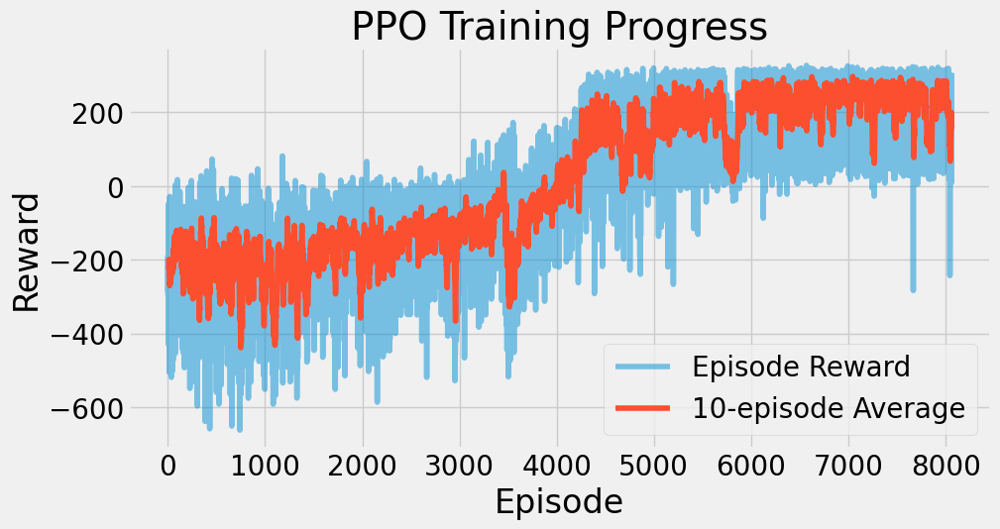

Model loaded from ppo_best_model.pt
Loaded best model for demo



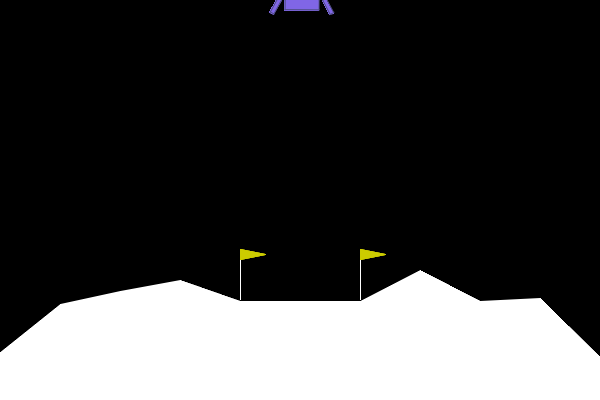

[array([[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        ...,
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],
 
        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [255, 255, 255],
  

In [ ]:
agent.plot_rewards()
agent.demo()